# Projet Analyse des données en R

In [1]:
library(MASS)
library(fda)
library(splines)
library(mclust)
library(fds)
library(rainbow)
library(pcaPP)
library(RCurl)
library(deSolve)
library(Matrix)
library(grid)
library(libcoin)
library(mvtnorm)
library(ggplot2)
library(lattice)
library(foreach)
library(iterators)
library(parallel)
library(itertools)
library(corrplot)
library(FactoMineR)
library(glmnet)
library(ROCR)
library(mlbench)
library(MASS)
library(boot)
library(class)
library(e1071)
library(rpart)
library(partykit)
library(nnet)
library(ipred)
library(gbm)
library(randomForest)
library(caret)
library(doParallel)
library(xgboost)
library(missForest)
library(Rlof)
library(dbscan)
library(kernlab)
library(lubridate)
library(moments)
library(ggpubr)
library(factoextra)
library(gmodels)
library(purrr)
library(gridExtra)

Warning message:
"le package 'MASS' a été compilé avec la version R 4.1.3"
Warning message:
"le package 'fda' a été compilé avec la version R 4.1.3"
Le chargement a nécessité le package : splines

Le chargement a nécessité le package : fds

Warning message:
"le package 'fds' a été compilé avec la version R 4.1.3"
Le chargement a nécessité le package : rainbow

Warning message:
"le package 'rainbow' a été compilé avec la version R 4.1.3"
Le chargement a nécessité le package : pcaPP

Warning message:
"le package 'pcaPP' a été compilé avec la version R 4.1.3"
Le chargement a nécessité le package : RCurl

Warning message:
"le package 'RCurl' a été compilé avec la version R 4.1.3"
Le chargement a nécessité le package : deSolve

Warning message:
"le package 'deSolve' a été compilé avec la version R 4.1.3"

Attachement du package : 'fda'


L'objet suivant est masqué depuis 'package:graphics':

    matplot


Warning message:
"le package 'mclust' a été compilé avec la version R 4.1.3"
Package '

ERROR: Error: le chargement du package ou de l'espace de noms a échoué pour 'caret' in loadNamespace(j <- i[[1L]], c(lib.loc, .libPaths()), versionCheck = vI[[j]]) :
le package 'glue' 1.6.1 est déjà chargé, mais >= 1.6.2 est requis


In [2]:
rm(list = ls())   # erase everything, start from scratch!

# load the data from package funFEM

library("funFEM")
data(velib)
help("velib")
#str(velib)

Warning message:
"le package 'funFEM' a été compilé avec la version R 4.1.3"
Le chargement a nécessité le package : elasticnet

Warning message:
"le package 'elasticnet' a été compilé avec la version R 4.1.3"
Le chargement a nécessité le package : lars

Warning message:
"le package 'lars' a été compilé avec la version R 4.1.3"
Loaded lars 1.3




In [3]:
# data preparation
x <- as.matrix(velib$data)
colnames(x) <- 1:ncol(x)
rownames(x) <- velib$names

n <- nrow(x)
stations <- 1:n 
coord <- velib$position[stations,]

# select exactly 7 days of data (we remove the first 13 dates)
dates <- 14:181
x <- x[, dates]
colnames(x) <- 1:length(dates)
head(x)

,1,2,3,4,5,6,7,8,9,10,...,159,160,161,162,163,164,165,166,167,168
EURYALE DEHAYNIN,0.03846154,0.03846154,0.07692308,0.03846154,0.03846154,0.03846154,0.03846154,0.03846154,0.10714286,0.00000000,...,0.29629630,0.11111111,0.1111111,0.14814815,0.30769231,0.07692308,0.11538462,0.07692308,0.1538462,0.1538462
LEMERCIER,0.47826087,0.47826087,0.47826087,0.43478261,0.43478261,0.43478261,0.43478261,0.43478261,0.26086957,0.04347826,...,0.04347826,0.00000000,0.2173913,0.13043478,0.04545455,0.17391304,0.17391304,0.17391304,0.2608696,0.3913043
MEZIERES RENNES,0.21818182,0.14545455,0.12727273,0.10909091,0.10909091,0.10909091,0.09090909,0.09090909,0.05454545,0.10909091,...,0.25925926,0.25925926,0.2037037,0.12962963,0.14814815,0.29629630,0.31481481,0.37037037,0.3703704,0.4074074
FARMAN,0.95238095,0.95238095,0.95238095,0.95238095,0.95238095,0.95238095,0.95238095,1.00000000,1.00000000,1.00000000,...,1.00000000,1.00000000,0.9047619,0.85714286,0.85714286,0.85714286,0.76190476,0.76190476,0.7619048,0.7619048
QUAI DE LA RAPEE,0.92753623,0.81159420,0.73913043,0.72463768,0.72463768,0.72463768,0.72463768,0.72463768,0.75362319,0.97101449,...,0.22727273,0.45454545,0.5909091,0.83333333,1.00000000,0.81818182,0.63636364,0.71212121,0.6212121,0.5757576
CHOISY POINT D'IVRY,0.16666667,0.16666667,0.16666667,0.16666667,0.16666667,0.16666667,0.16666667,0.16666667,0.08333333,0.00000000,...,0.34782609,0.08695652,0.1153846,0.08695652,0.13043478,0.08695652,0.08695652,0.43478261,0.3913043,0.5217391


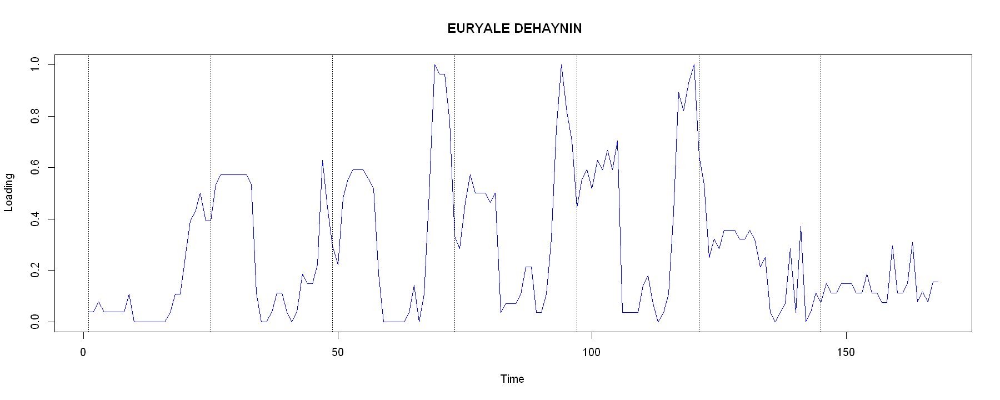

In [4]:
timeTick <- 1 + 24*(0:6)  # vector corresponding to the beginning of days
par(mfrow = c(1, 1))
options(repr.plot.width = 15, repr.plot.height = 6)

plot(x[1, ], col = "blue", type = "l", ylim = c(0, 1), 
     xlab = "Time", ylab = "Loading", main = rownames(x)[1])
abline(v = timeTick, lty = "dotted")

In [5]:
# From now on, we use numbers instead of station names, 
# in order to simplify printing
rownames(x) <- 1:nrow(x)

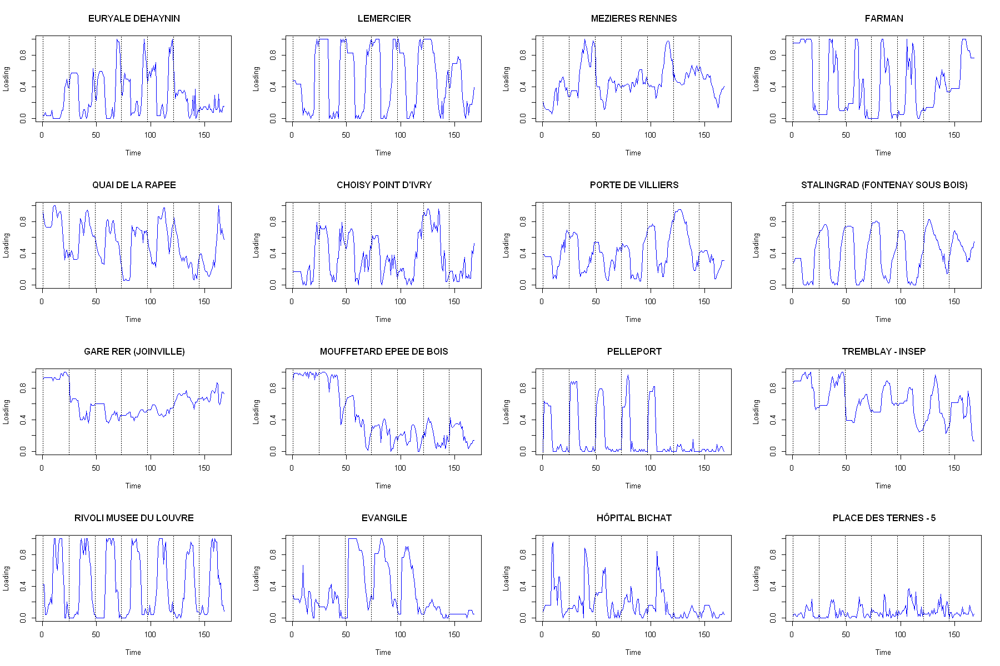

In [6]:
# description des stations en fonction du temps
par(mfrow = c(4, 4))
options(repr.plot.width = 15, repr.plot.height = 10)

for (i in 1:16){
    plot(x[i, ], col = "blue", type = "l", ylim = c(0, 1), 
         xlab = "Time", ylab = "Loading", main = velib$names[i])
    abline(v = timeTick, lty = "dotted")
}

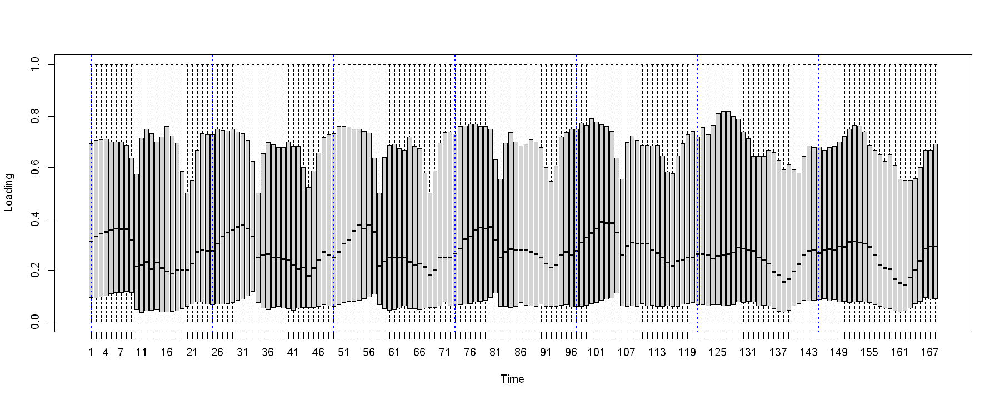

In [8]:
options(repr.plot.width = 15, repr.plot.height = 6)
stats <- boxplot(x, xlab = "Time", ylab = "Loading")
abline(v = timeTick, lty = "dotted", col = "blue", lwd = 2)

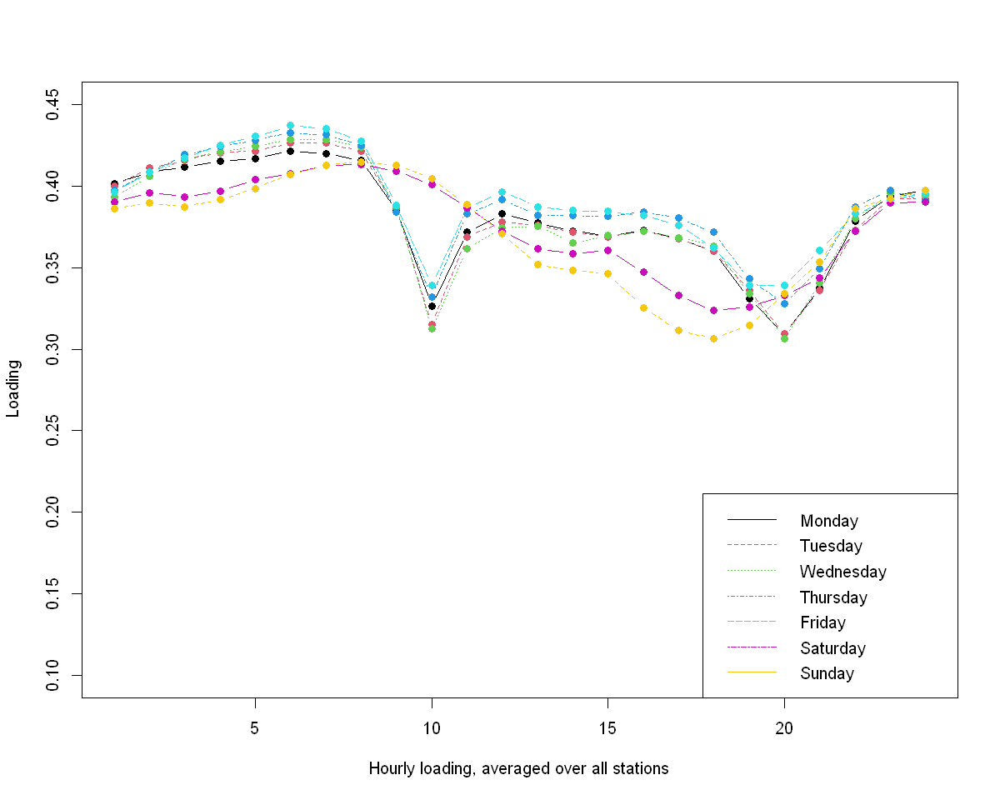

In [9]:
xHour <- colMeans(x)
# alternatively, one can use the median returned by boxplot
# xHour <- stats$stats[3, ]
xHour <- matrix(xHour, nrow = 24)  # rearranged in columns (column 1 contains the stations 1, 2, ..., 24) 

options(repr.plot.width = 10, repr.plot.height = 8)
dayText <- c("Mon", "Tues", "Wednes", "Thurs", "Fri", "Satur", "Sun")
dayText <- paste(dayText, "day", sep = "")
matplot(xHour, type = "b", ylim = c(0.1, 0.45), col = 1:7, pch = 19, 
        xlab = "Hourly loading, averaged over all stations", ylab = "Loading")
legend("bottomright", dayText, lty = 1:7, col = 1:7)

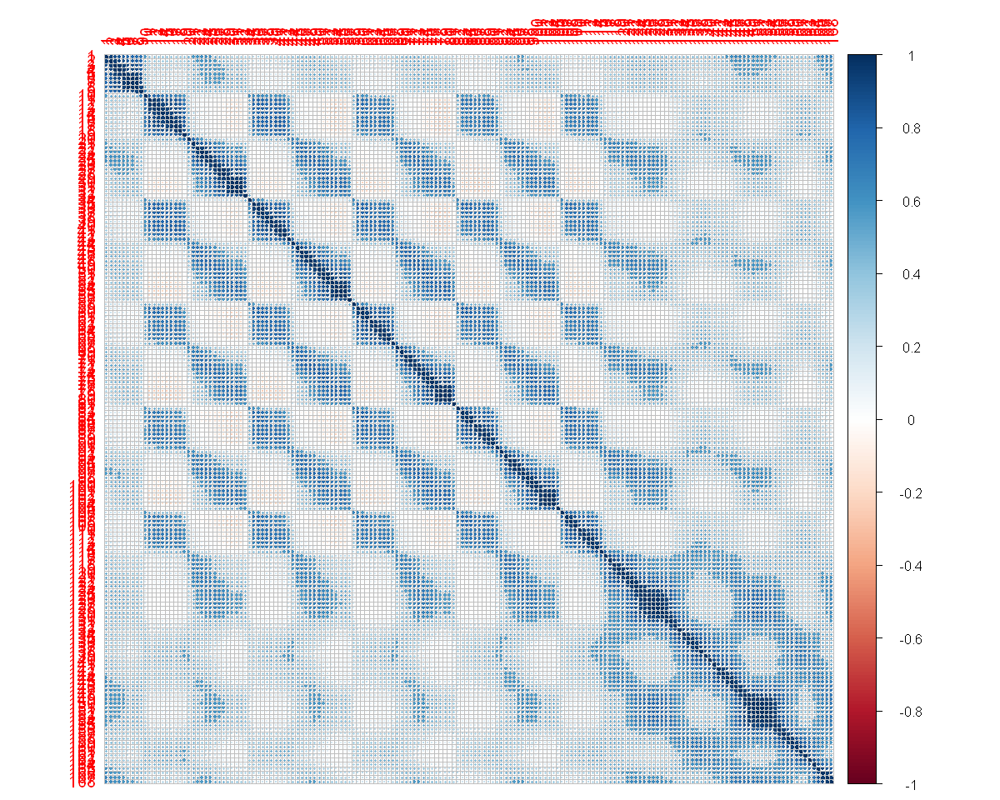

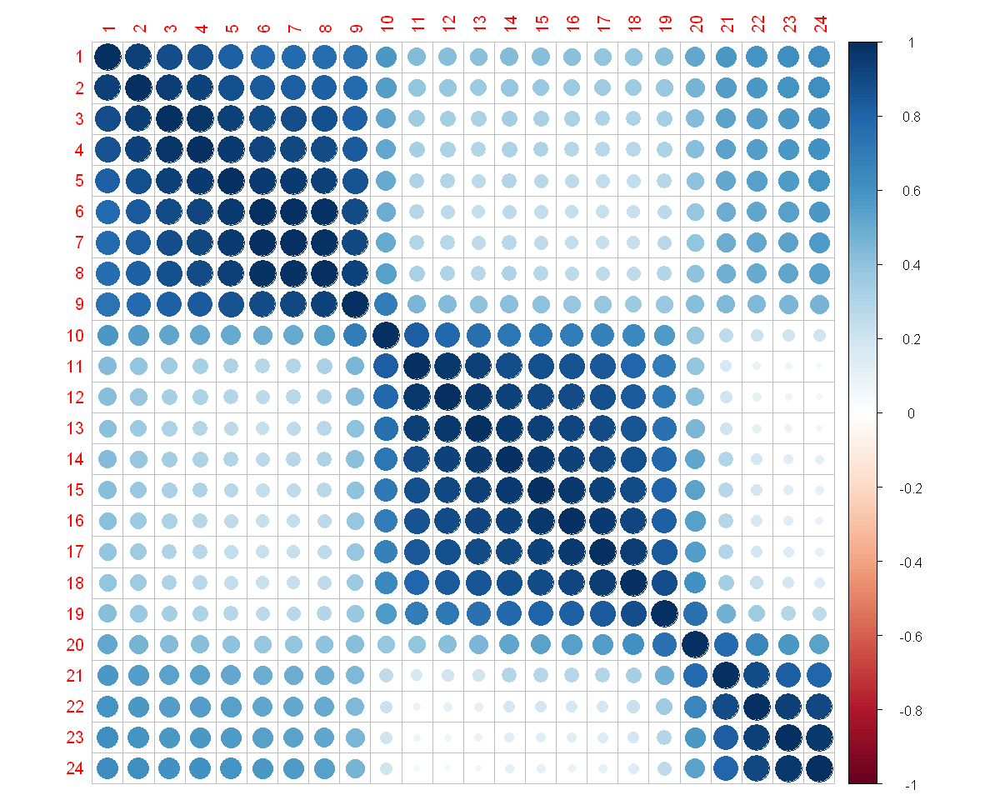

In [10]:
library(corrplot)
corrplot(cor(x))
corrplot(cor(x[,1:24]))

Warning message:
"le package 'ggmap' a été compilé avec la version R 4.1.3"
Google's Terms of Service: https://cloud.google.com/maps-platform/terms/.

Please cite ggmap if you use it! See citation("ggmap") for details.

Using zoom = 12...

Source : http://tile.stamen.com/terrain/12/2073/1408.png

Source : http://tile.stamen.com/terrain/12/2074/1408.png

Source : http://tile.stamen.com/terrain/12/2075/1408.png

Source : http://tile.stamen.com/terrain/12/2076/1408.png

Source : http://tile.stamen.com/terrain/12/2073/1409.png

Source : http://tile.stamen.com/terrain/12/2074/1409.png

Source : http://tile.stamen.com/terrain/12/2075/1409.png

Source : http://tile.stamen.com/terrain/12/2076/1409.png

Source : http://tile.stamen.com/terrain/12/2073/1410.png

Source : http://tile.stamen.com/terrain/12/2074/1410.png

Source : http://tile.stamen.com/terrain/12/2075/1410.png

Source : http://tile.stamen.com/terrain/12/2076/1410.png



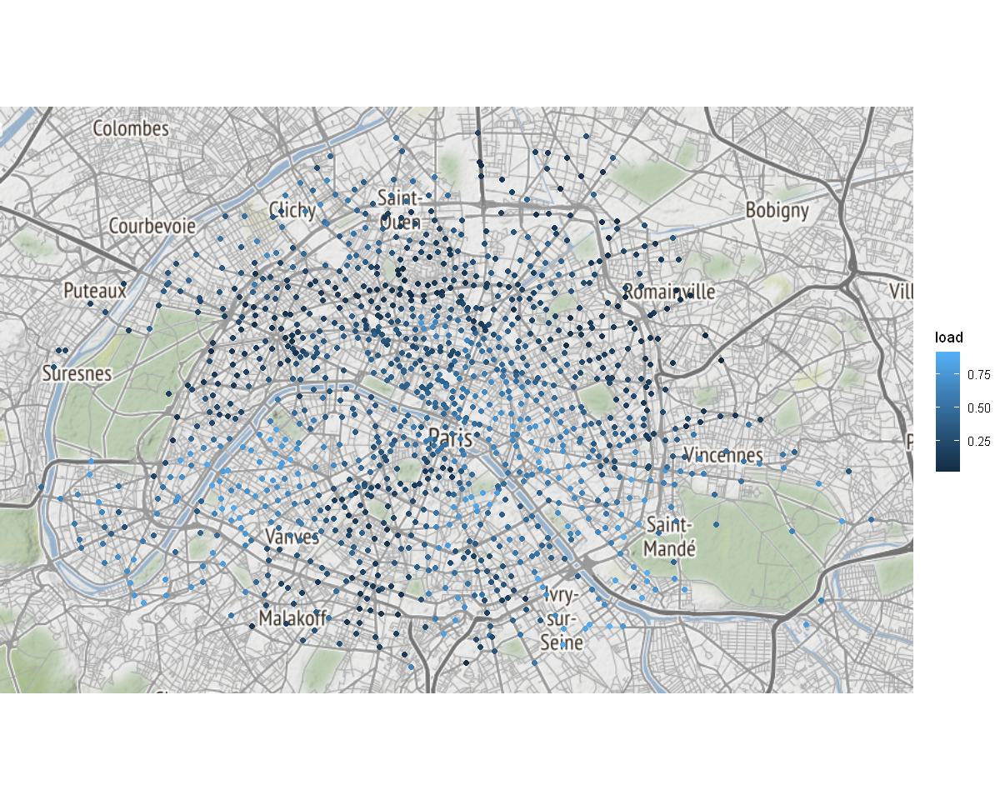

In [11]:
library(ggmap)
# Average loading for each station
load <- rowMeans(x)  
qmplot(longitude, latitude, data = velib$position, color = load)
# Average loading at 6h, 12h et 23h (the first time step is 0h)

load6 <- rowMeans(x[, seq(from = 6, by = 24, length = 7)])
load12 <- rowMeans(x[, seq(from = 13, by = 24, length = 7)])
load23 <- rowMeans(x[, seq(from = 24, by = 24, length = 7)])
# decommenter les lignes ci-dessous pour execution
# qmplot(longitude, latitude, data = velib$position, color = load6)
# qmplot(longitude, latitude, data = velib$position, color = load12)
# qmplot(longitude, latitude, data = velib$position, color = load23)

Using zoom = 12...



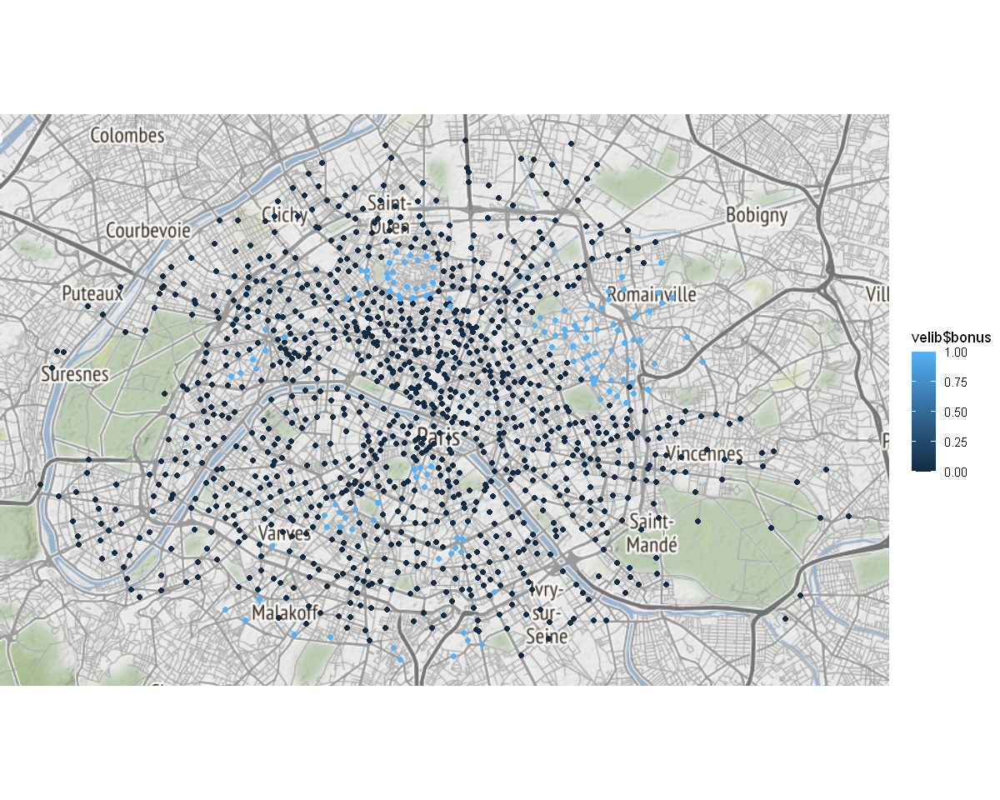

In [12]:
# visualisation des station hill ou non h...ill
#options(repr.plot.width = 10, repr.plot.height = 10)
#plot(velib$position, col = ifelse(velib$bonus, "blue", "black"),pch = ifelse(velib$bonus, 19, 1))
# With ggmap
#Decommenter pour executer
qmplot(longitude, latitude, data = velib$position, color = velib$bonus)

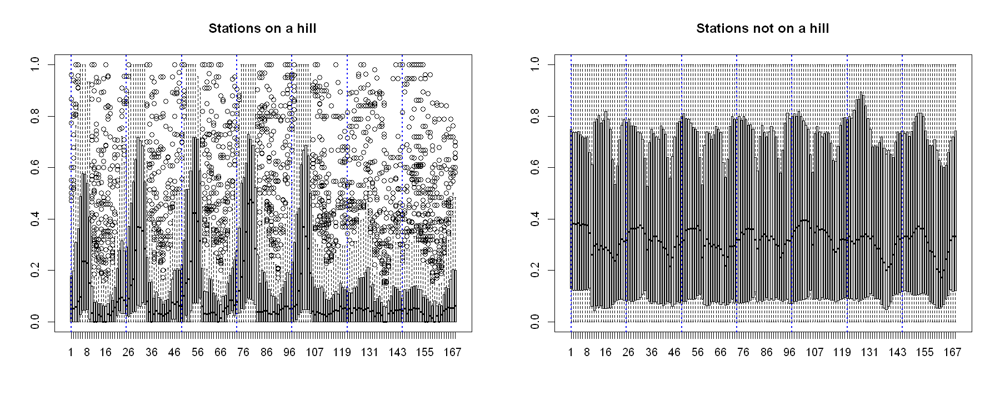

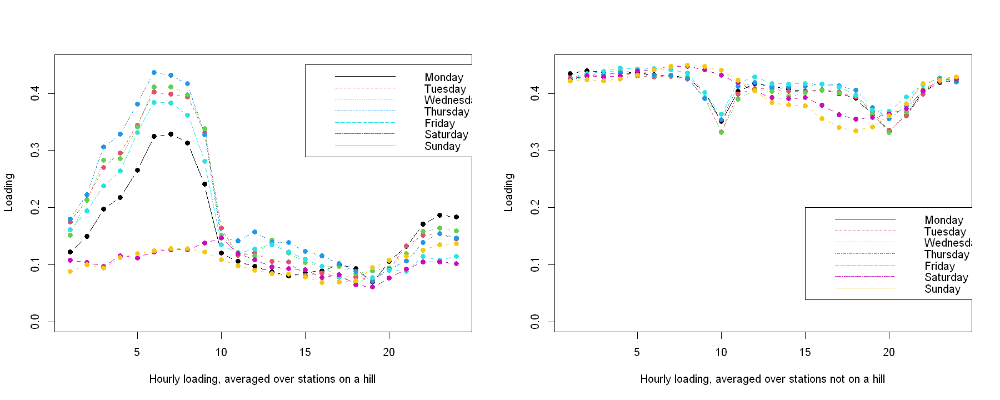

In [13]:
xHill <- x[velib$bonus == 1, ]
xNoHill <- x[velib$bonus == 0, ]
options(repr.plot.width = 15, repr.plot.height = 6)
par(mfrow = c(1, 2))

boxplot(xHill, main = "Stations on a hill")
abline(v = timeTick, lty = "dotted", col = "blue", lwd = 2)

boxplot(xNoHill, main = "Stations not on a hill")
abline(v = timeTick, lty = "dotted", col = "blue", lwd = 2)

xHourHill <- matrix(colMeans(xHill), nrow = 24)
xHourNoHill <- matrix(colMeans(xNoHill), nrow = 24)
options(repr.plot.width = 15, repr.plot.height = 6)
par(mfrow = c(1, 2))
matplot(xHourHill, type = "b", ylim = c(0, 0.45), col = 1:7, pch = 19, 
        xlab = "Hourly loading, averaged over stations on a hill", ylab = "Loading")
legend(x = 15, y = 0.45, dayText, lty = 1:7, col = 1:7)
matplot(xHourNoHill, type = "b", ylim = c(0, 0.45), col = 1:7, pch = 19, 
        xlab = "Hourly loading, averaged over stations not on a hill", ylab = "Loading")
legend(x = 15, y = 0.2, dayText, lty = 1:7, col = 1:7)


# ACP

In [14]:
velo1<-velib$data
velo <- data.frame(hill = as.factor(velib$bonus),velo1)

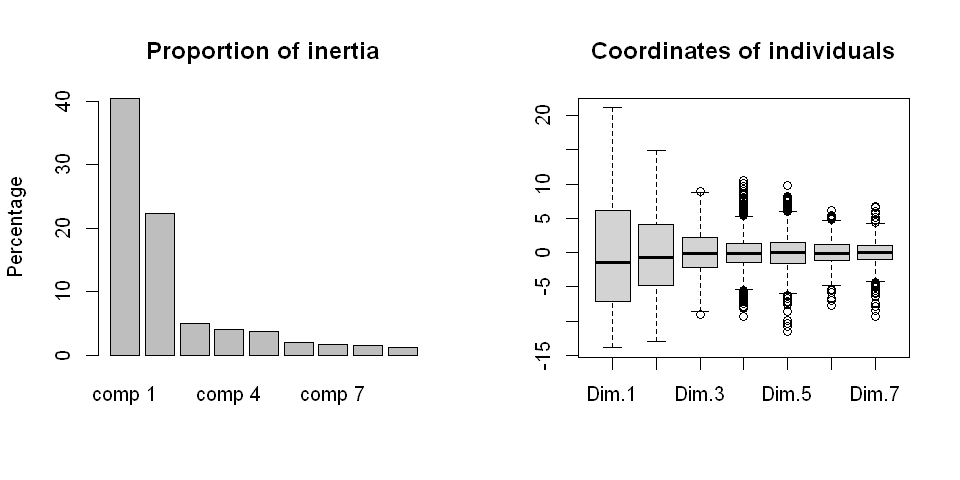

In [15]:
acp <- PCA(velo, scale.unit = TRUE,
           graph = FALSE,quali.sup = 1,ncp = 7)
options(repr.plot.width = 8, repr.plot.height = 4)
par(mfrow = c(1, 2))
barplot(acp$eig[1:9, 2], ylab = "Percentage", main = "Proportion of inertia")
boxplot(acp$ind$coord, main = "Coordinates of individuals")
#on garde 5 composant

Warning message:
"ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


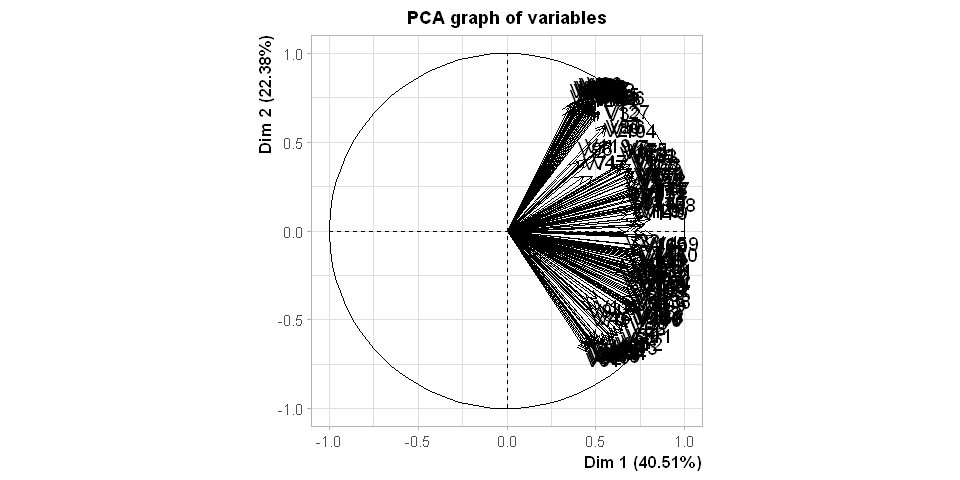

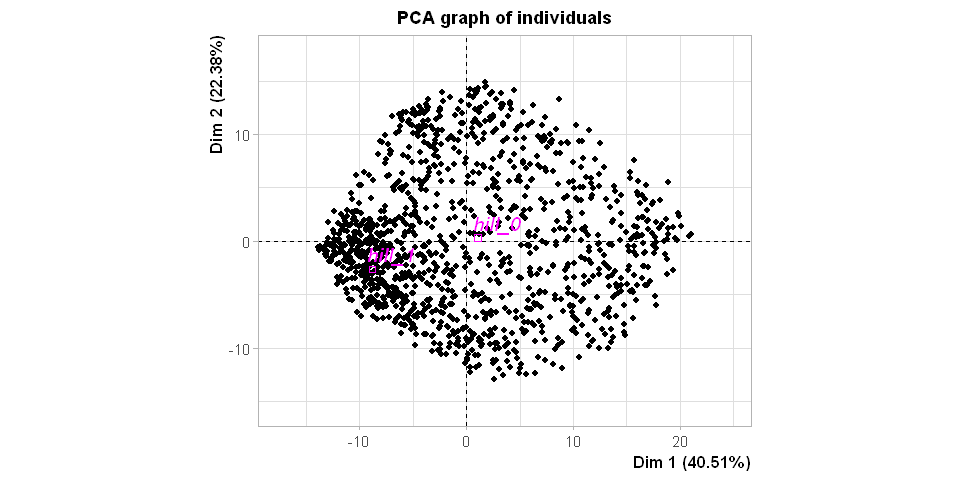

In [16]:
plot(acp, choix = "varcor")
plot(acp, choix = "ind", select = "contrib 3", unselect = 0)

In [17]:
a=which.max(acp$ind$coord[,2])
b=which.min(acp$ind$coord[,2])
c=which.max(acp$ind$coord[,1])
d=which.min(acp$ind$coord[,1])

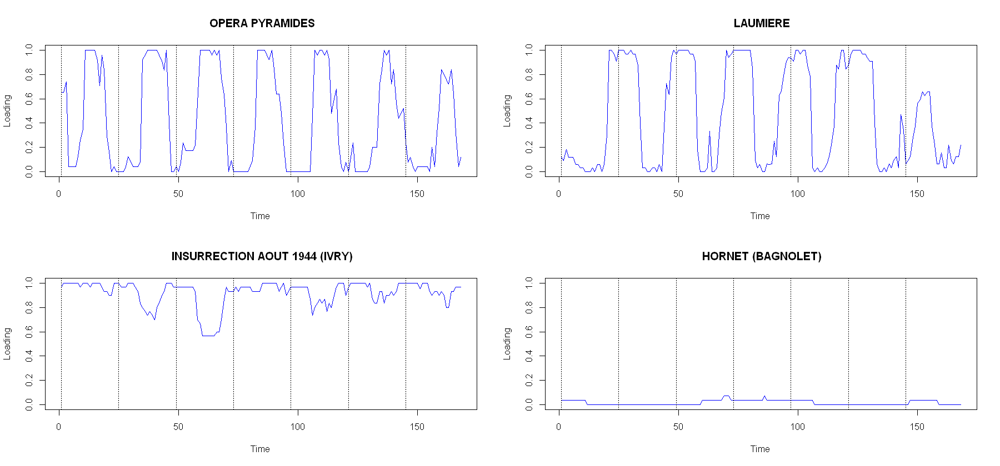

In [18]:
par(mfrow = c(2, 2))
options(repr.plot.width = 15, repr.plot.height = 7)
# station max dim 2
plot(x[a, ], col = "blue", type = "l", ylim = c(0, 1), xlab = "Time", ylab = "Loading", main = velib$names[a])
abline(v = timeTick, lty = "dotted")
# station min dim 2
plot(x[b, ], col = "blue", type = "l", ylim = c(0, 1), xlab = "Time", ylab = "Loading", main = velib$names[b])
abline(v = timeTick, lty = "dotted")
# station max dim 1
plot(x[c, ], col = "blue", type = "l", ylim = c(0, 1), xlab = "Time", ylab = "Loading", main = velib$names[c])
abline(v = timeTick, lty = "dotted")
# station min dim 1
plot(x[d, ], col = "blue", type = "l", ylim = c(0, 1), xlab = "Time", ylab = "Loading", main = velib$names[d])
abline(v = timeTick, lty = "dotted")

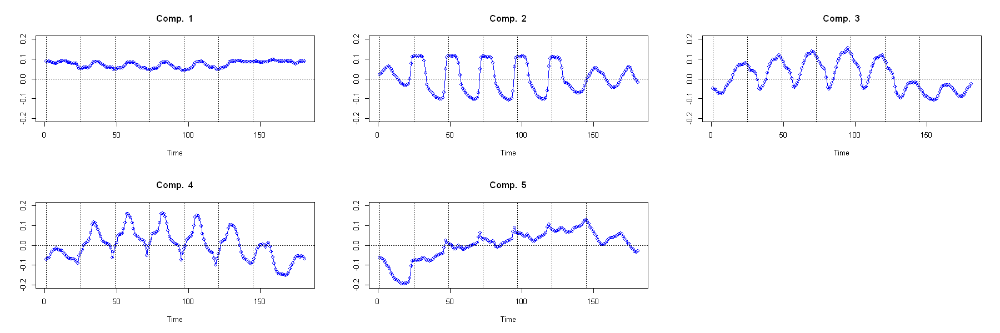

In [21]:
options(repr.plot.width = 15, repr.plot.height = 5)
par(mfrow = c(2,3))
for (i in 1:5){
    plot(acp$svd$V[, i], type = "o", main = paste("Comp. ", i), xlab = "Time", ylab = "",
         ylim = c(-0.2, 0.2), col = "blue")
    abline(h = 0, lty = "dotted")
    abline(v = timeTick, lty = "dotted")
}

# Classification non supervisée

Problème, plus de cluster choisi, plus de détail on a mai très dur à interprêter. En revanche, moins de cluster choisi, plus on arrive à interprêter les clusters.

## Hierarchical clustering

In [22]:
Acp_preparer=acp$ind$coord[,1:5]

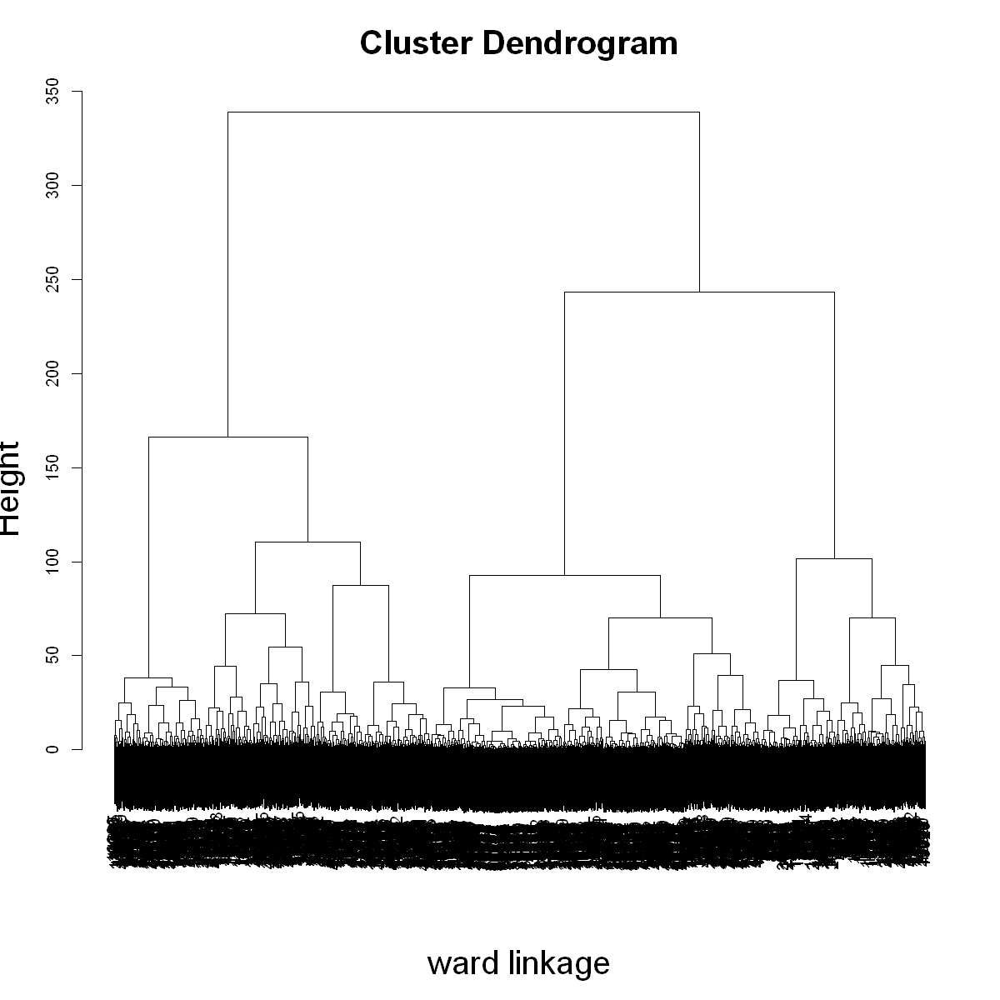

In [23]:
hc <- hclust(dist(Acp_preparer), method = "ward.D2")
options(repr.plot.width = 10, repr.plot.height = 10)
plot(hc, xlab = "ward linkage", sub = "", cex.lab = 2, cex.main = 2)

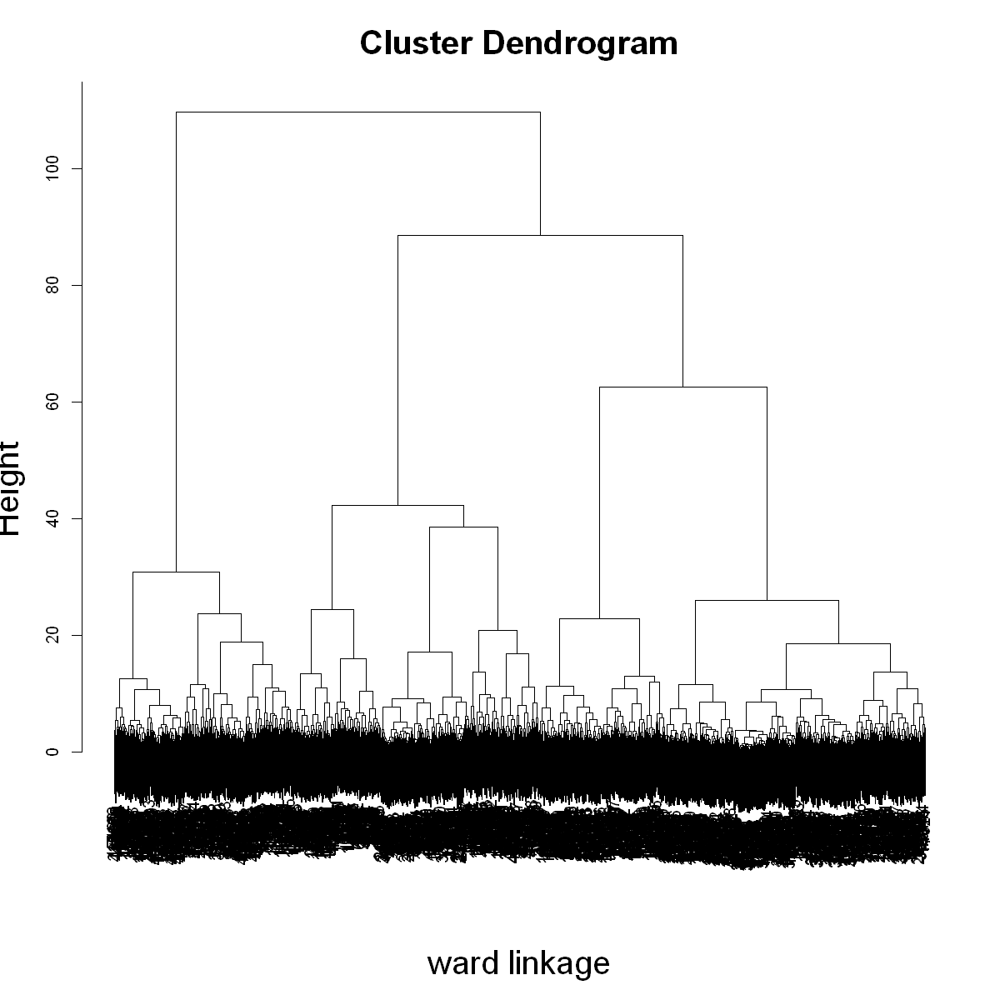

In [24]:
# Hierarchical clustering sur data complet

hc1 <- hclust(dist(velib$data), method = "ward.D2")
plot(hc1, xlab = "ward linkage", sub = "", cex.lab = 2, cex.main = 2)

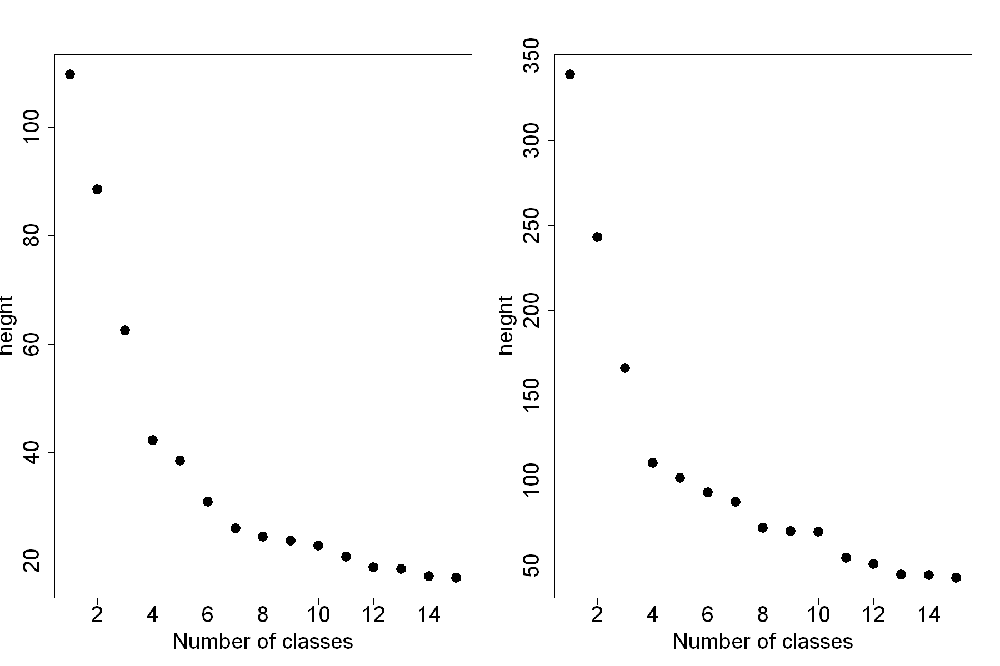

In [25]:
options(repr.plot.width = 15, repr.plot.height = 10)
par(mfrow = c(1,2))
plot(rev(hc1$height)[1:15], xlab = "Number of classes", ylab = "height", #full data
     cex.lab = 2, cex.main = 2, cex.axis = 2, cex = 2, pch = 19)
# on chosit 7 cluster

plot(rev(hc$height)[1:15], xlab = "Number of classes", ylab = "height", #ACP
     cex.lab = 2, cex.main = 2, cex.axis = 2, cex = 2, pch = 19)
# on chosit 4 cluster



Using zoom = 12...



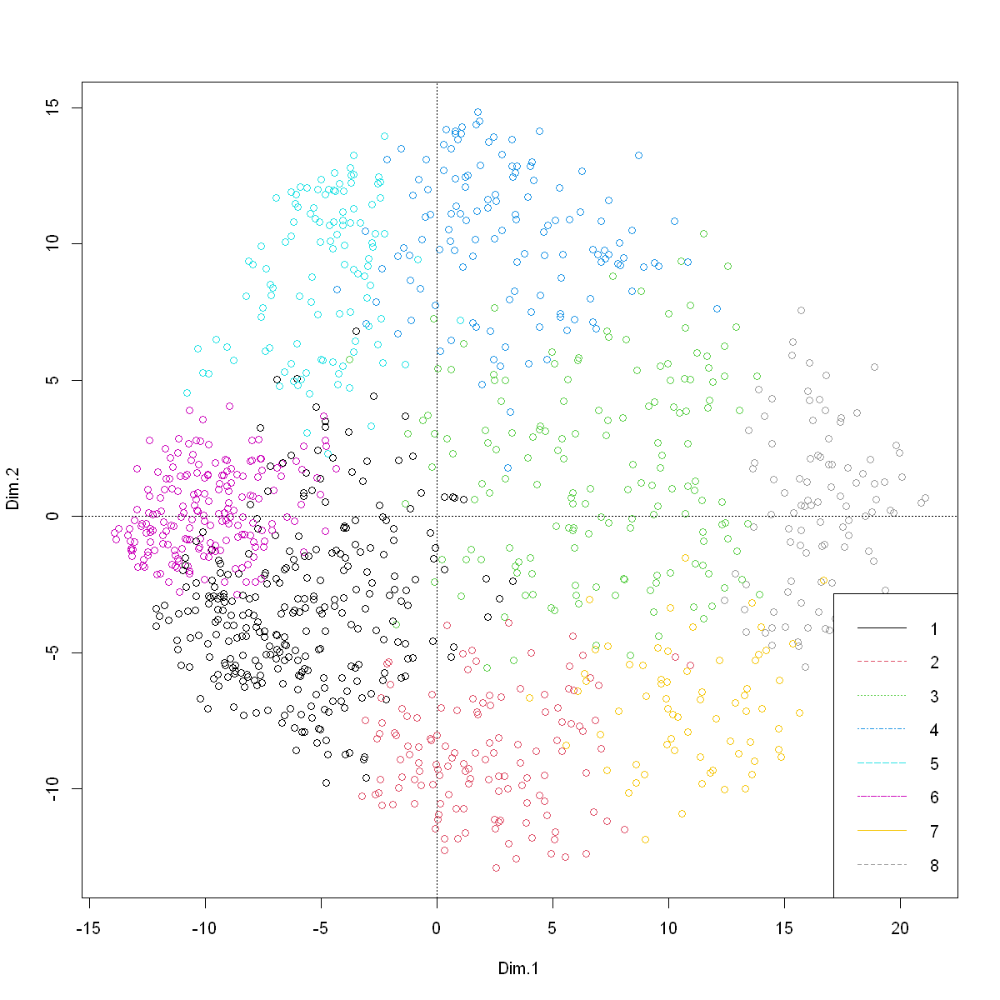

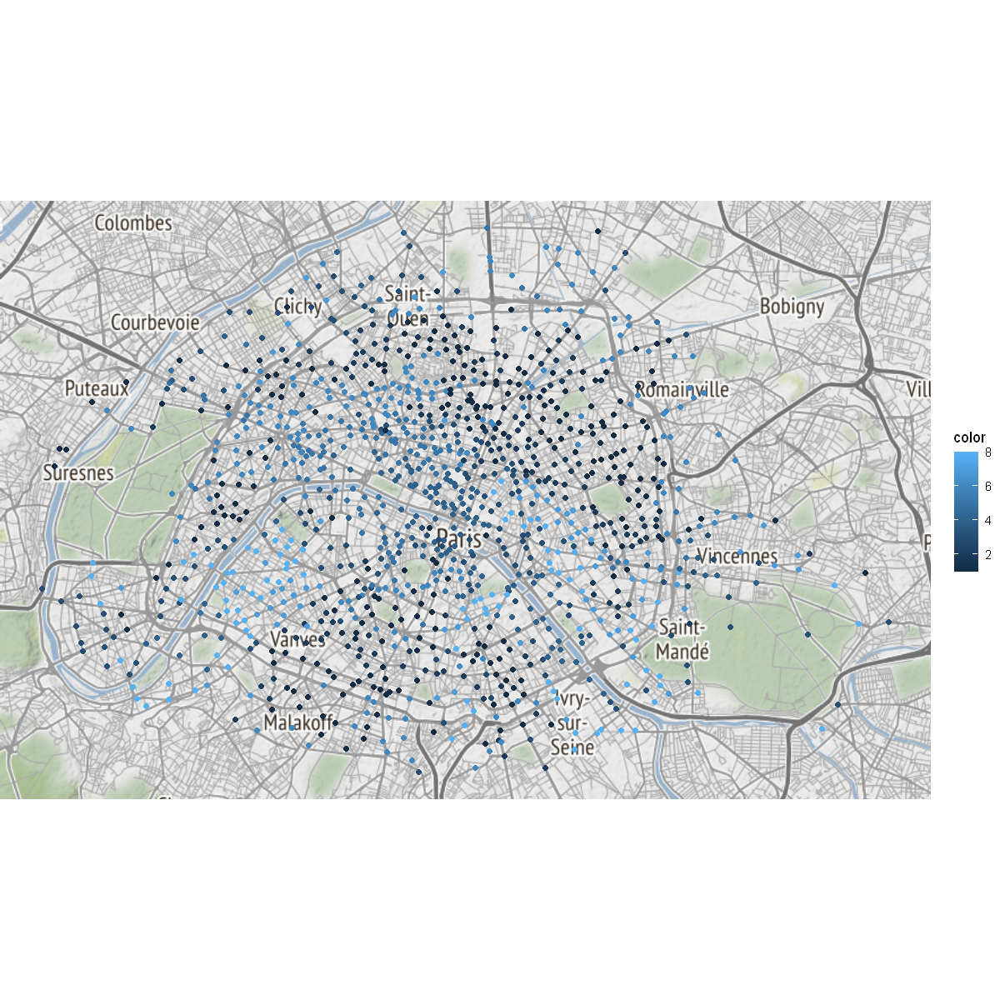

In [26]:
color=cutree(hc,8)
options(repr.plot.width=10, repr.plot.height=10)
plot(Acp_preparer, col=color)
abline(v = 0,h=0, lty = "dotted")
legend("bottomright", legend=c(1:8), lty = 1:9, col = 1:9)
# Pour 4 cluster on a plus ou moins les mêmes cluster que K_means donc pas nécessaire 
qmplot(longitude, latitude, data = velib$position, color = color)

Using zoom = 12...



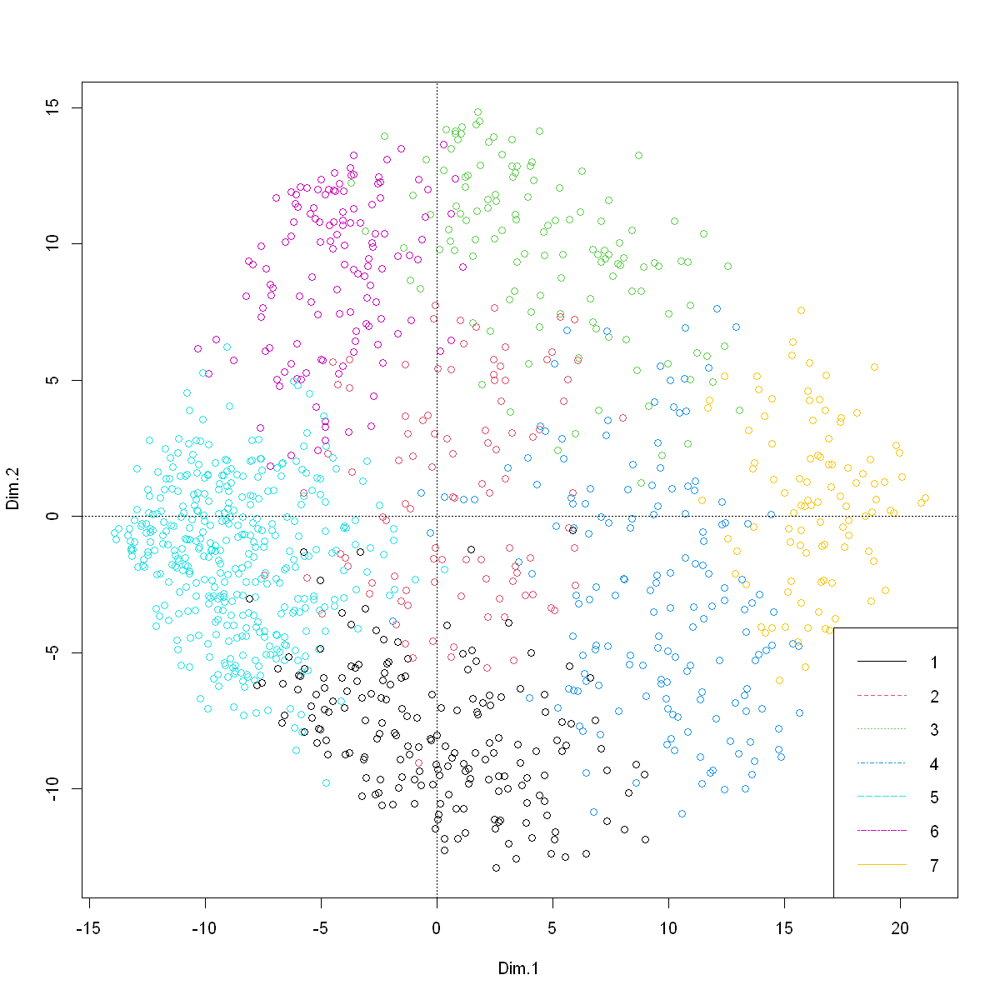

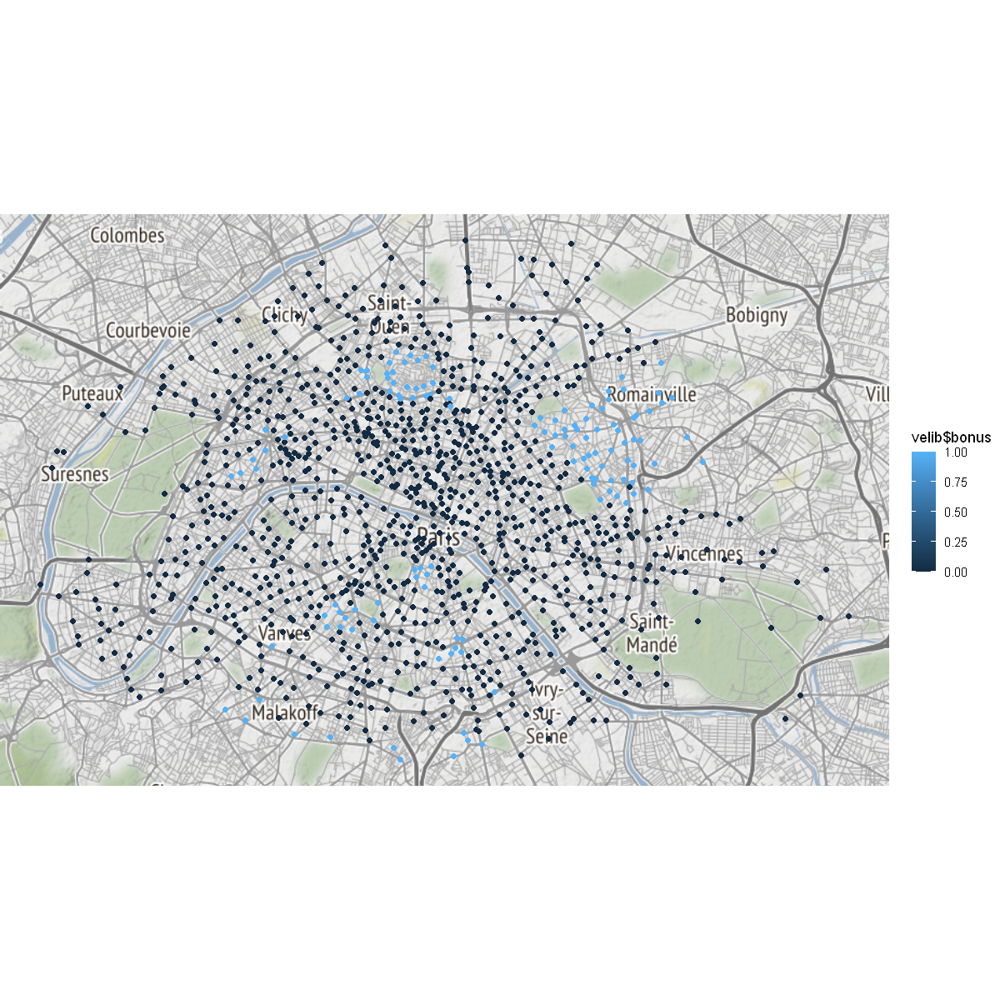

In [27]:
color1=cutree(hc1,7)
plot(Acp_preparer, col=color1)
abline(v = 0,h=0, lty = "dotted")
legend("bottomright", legend=c(1:7), lty = 1:9, col = 1:9)

qmplot(longitude, latitude, data = velib$position, color = velib$bonus)

Using zoom = 12...

Using zoom = 12...



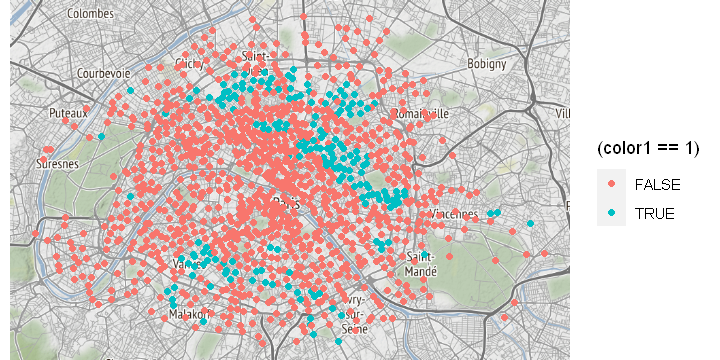

Using zoom = 12...



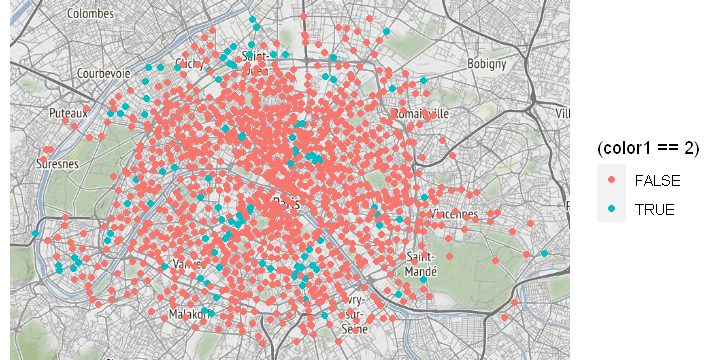

Using zoom = 12...



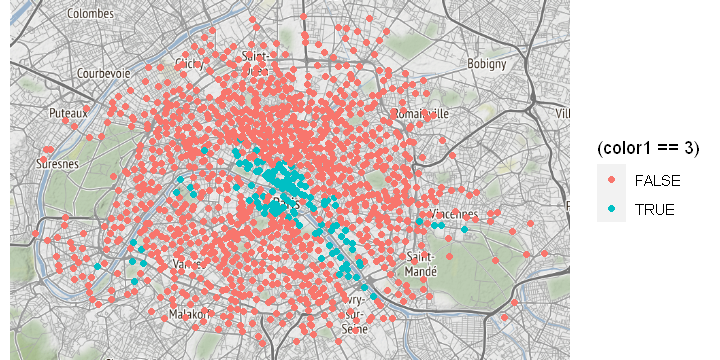

Using zoom = 12...



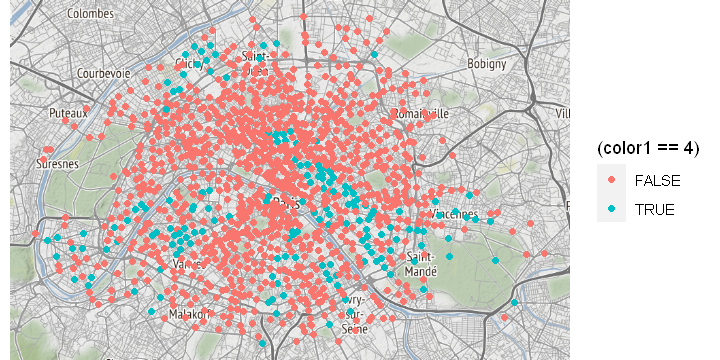

Using zoom = 12...



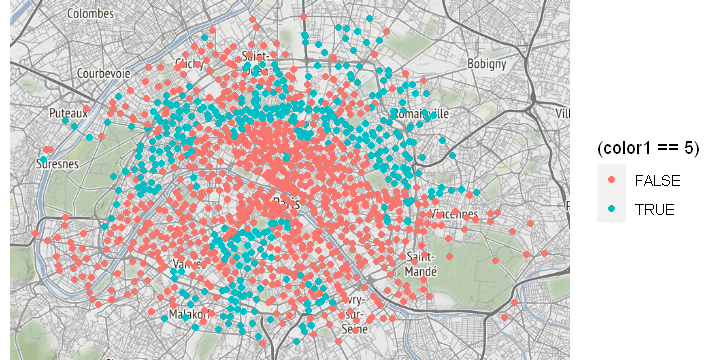

Using zoom = 12...



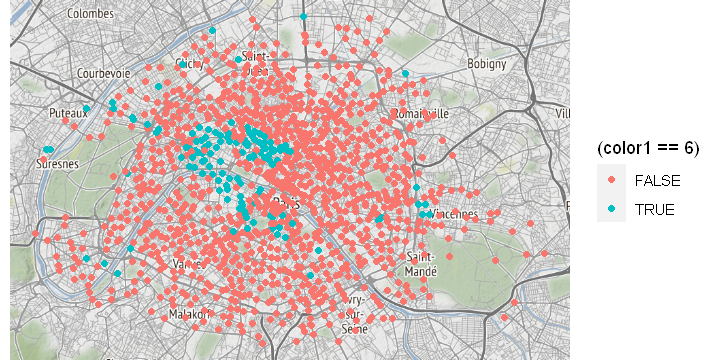

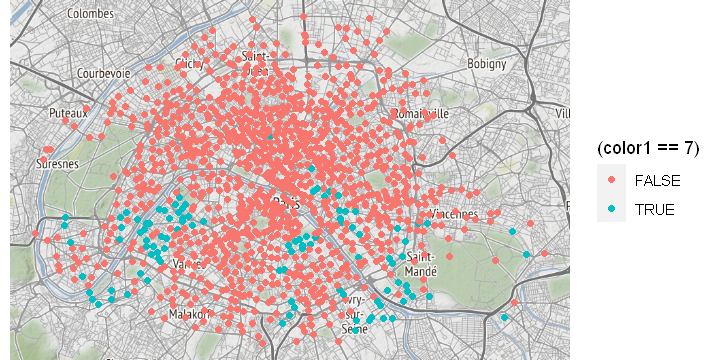

In [28]:
options(repr.plot.width = 6, repr.plot.height = 3)
qmplot(longitude, latitude, data = velib$position, color = (color1==1))
qmplot(longitude, latitude, data = velib$position, color = (color1==2))
qmplot(longitude, latitude, data = velib$position, color = (color1==3))
qmplot(longitude, latitude, data = velib$position, color = (color1==4))
qmplot(longitude, latitude, data = velib$position, color = (color1==5))
qmplot(longitude, latitude, data = velib$position, color = (color1==6))
qmplot(longitude, latitude, data = velib$position, color = (color1==7))


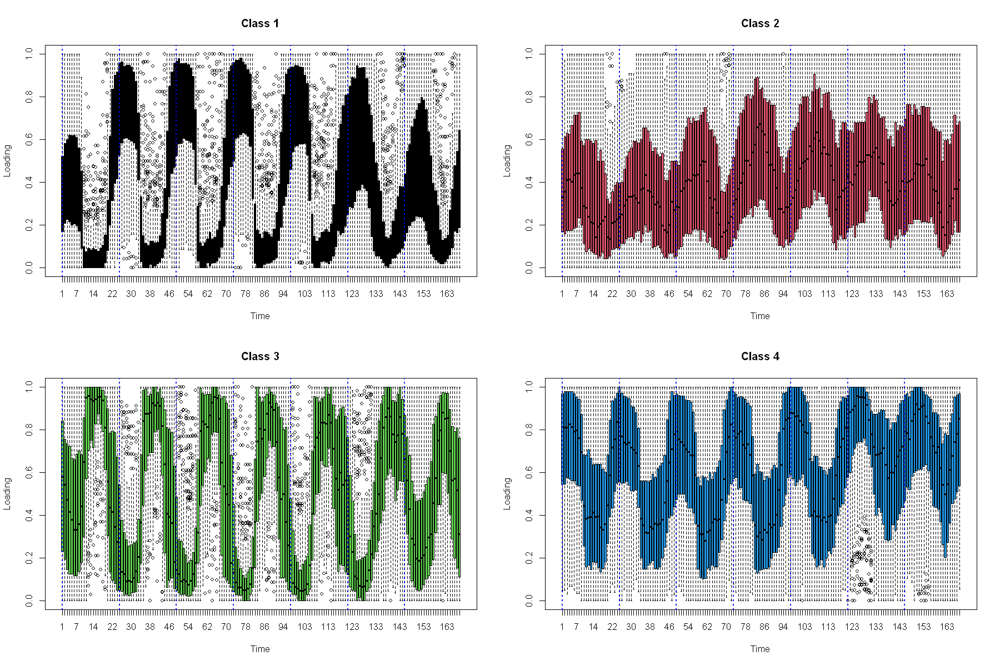

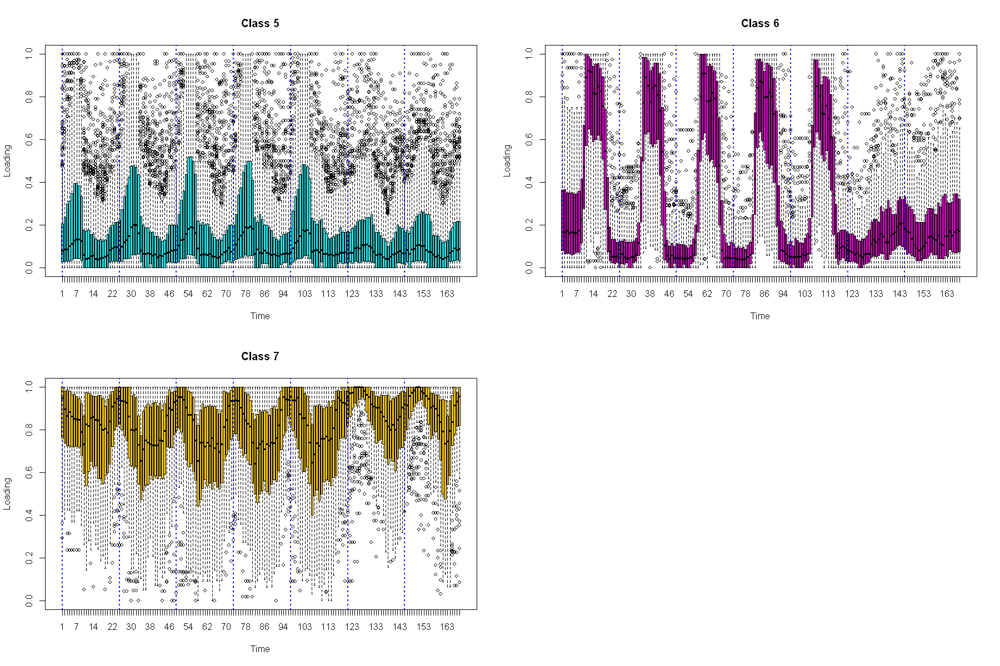

In [29]:
#visualization of the clusters, as time series
options(repr.plot.width = 15, repr.plot.height = 10)
par(mfrow = c(2, 2))
for (l in 1:7){
  boxplot(x[which(color1 == l), ], col = l, 
          xlab = "Time", ylab = "Loading", main = paste("Class", l))
          abline(v = timeTick, lty = "dotted", col = "blue", lwd = 2)
}

## Kmeans clustering

Il y a deux choix : 4 ou 7 et il faut interprêter

Using zoom = 12...



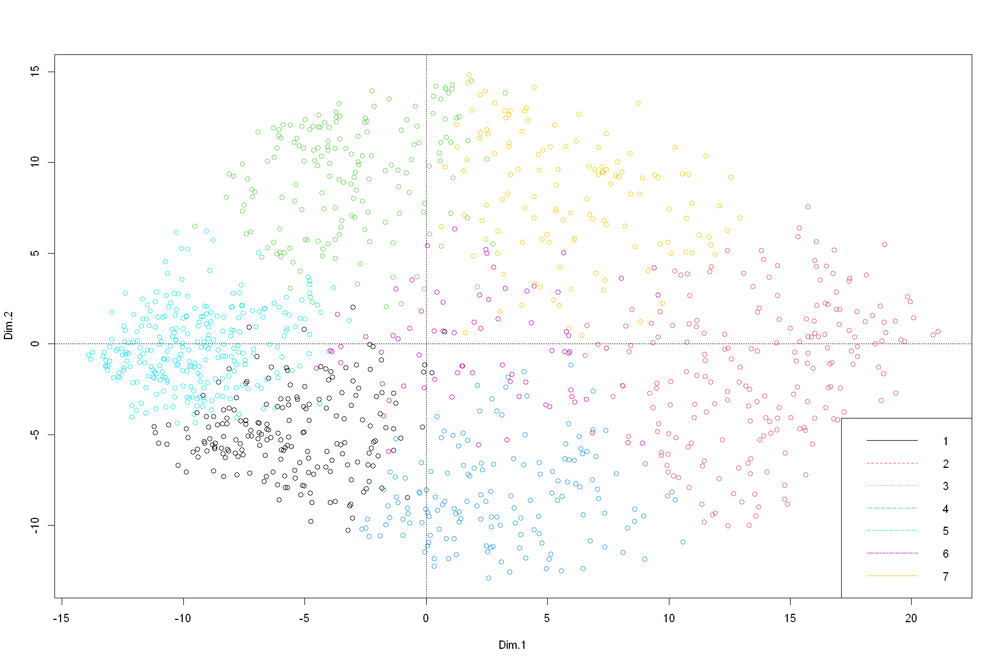

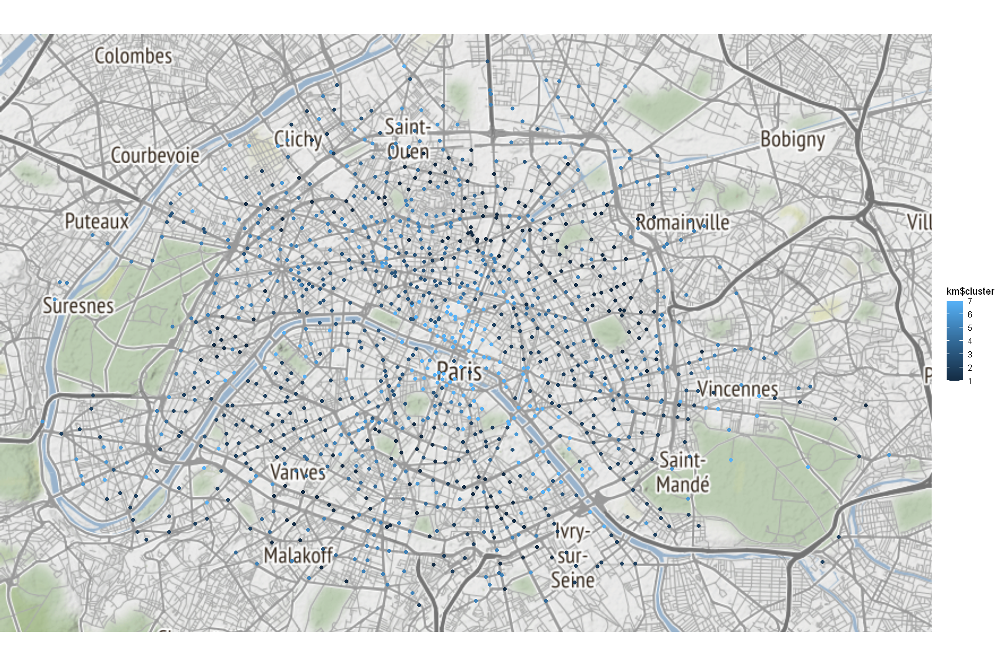

In [31]:
km=kmeans(Acp_preparer,7)
plot(Acp_preparer, col=km$cluster)
abline(v = 0,h=0, lty = "dotted")
legend("bottomright", legend=c(1:7), lty = 1:9, col = 1:9)

qmplot(longitude, latitude, data = velib$position, color = km$cluster)

In [32]:
# Kmeans clustering sur data complet
km1=kmeans(velo1,7)

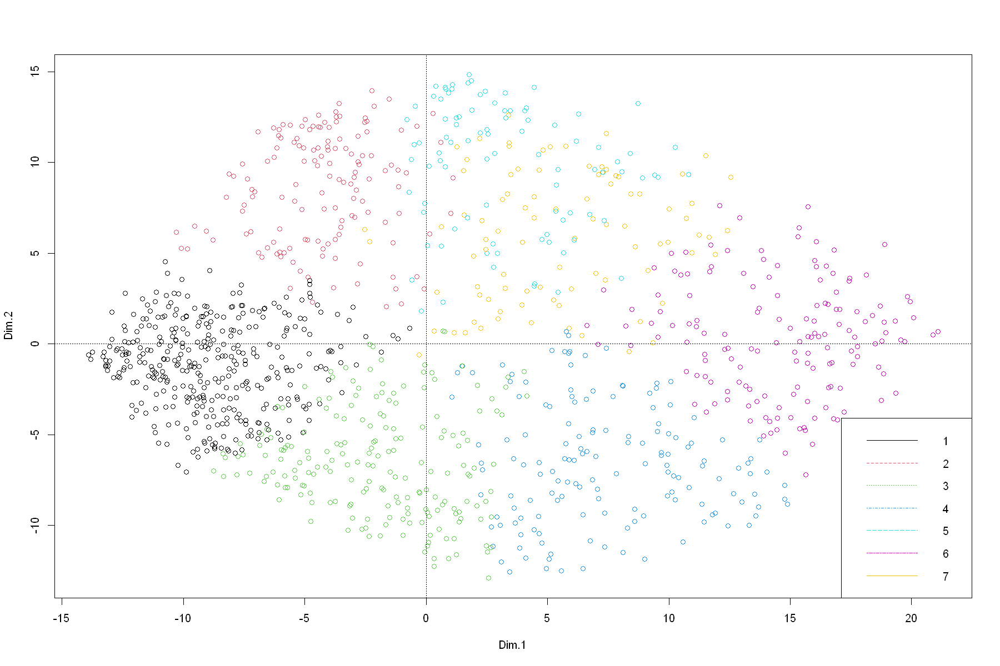

In [33]:
plot(Acp_preparer, col=km1$cluster)
abline(v = 0,h=0, lty = "dotted")
legend("bottomright", legend=c(1:7), lty = 1:9, col = 1:9)

Using zoom = 12...

Using zoom = 12...



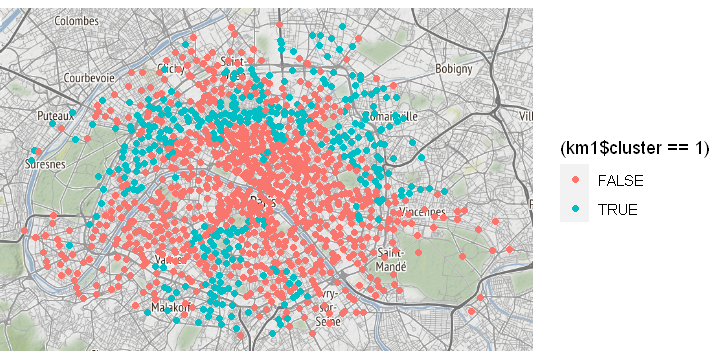

Using zoom = 12...



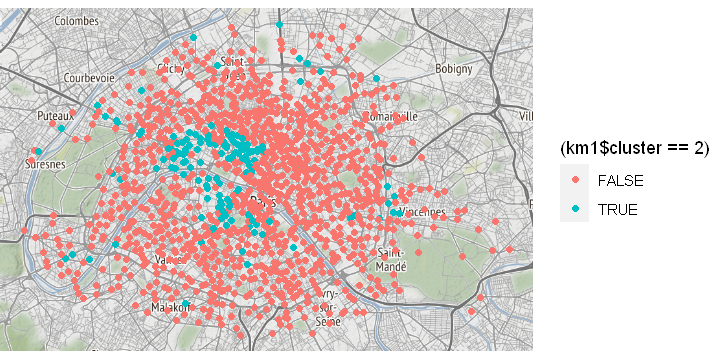

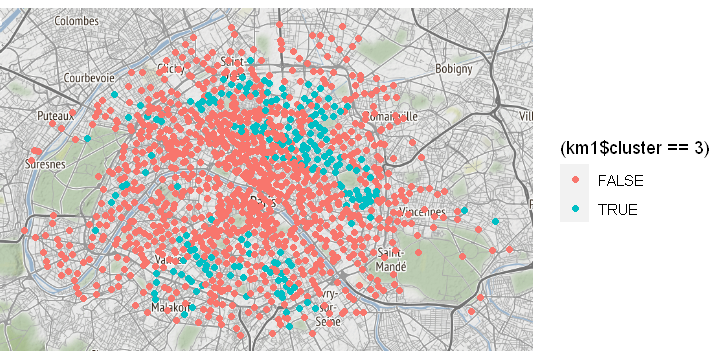

In [34]:
options(repr.plot.width = 6, repr.plot.height = 3)
qmplot(longitude, latitude, data = velib$position, color = (km1$cluster==1))
qmplot(longitude, latitude, data = velib$position, color = (km1$cluster==2))
qmplot(longitude, latitude, data = velib$position, color = (km1$cluster==3))

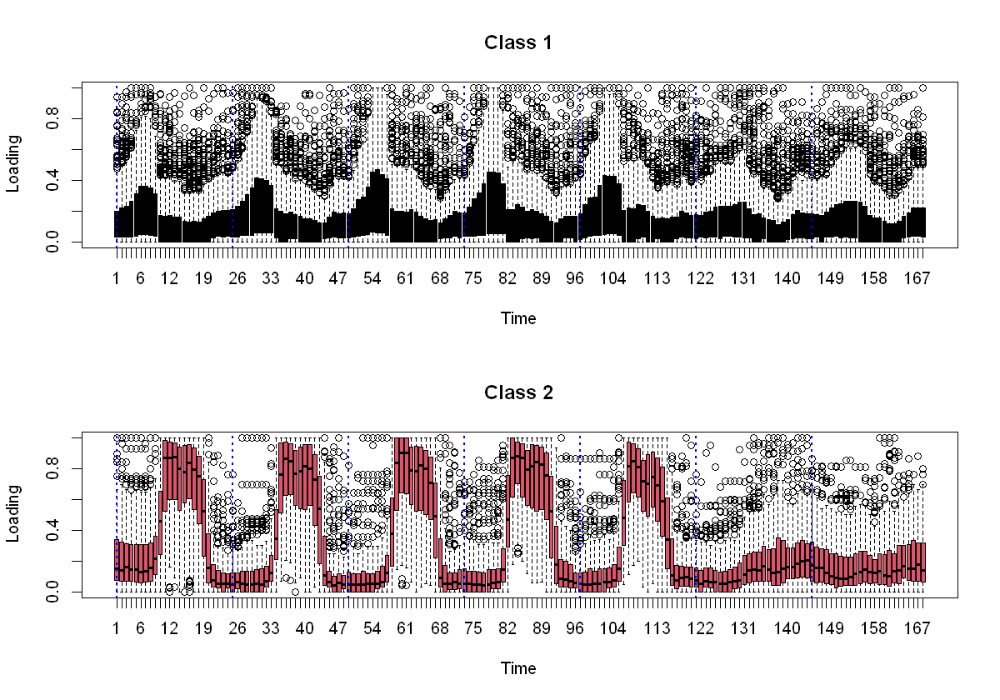

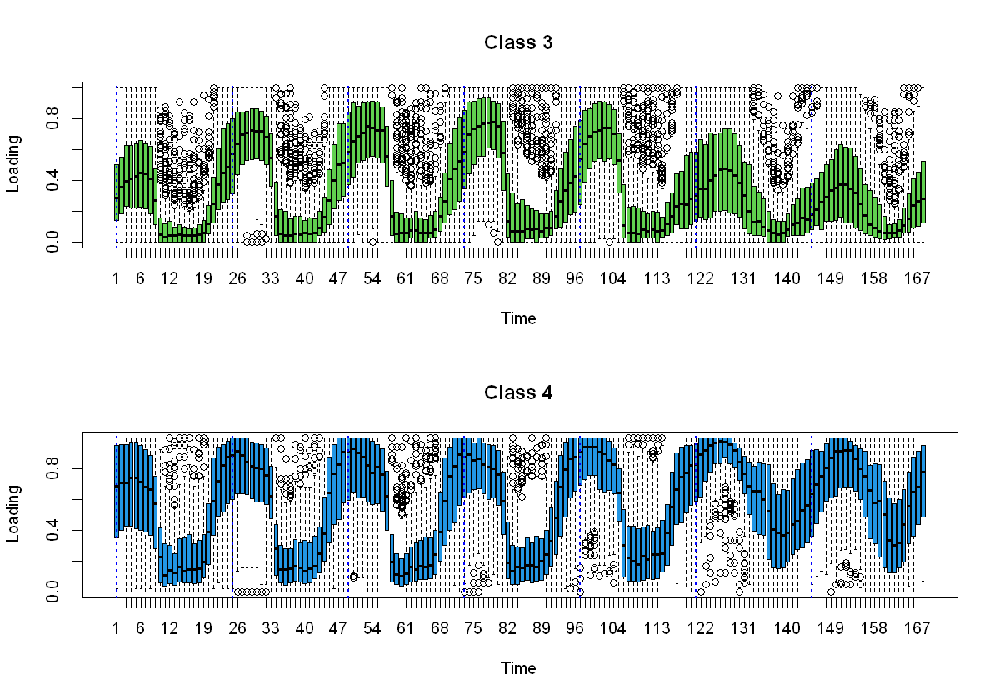

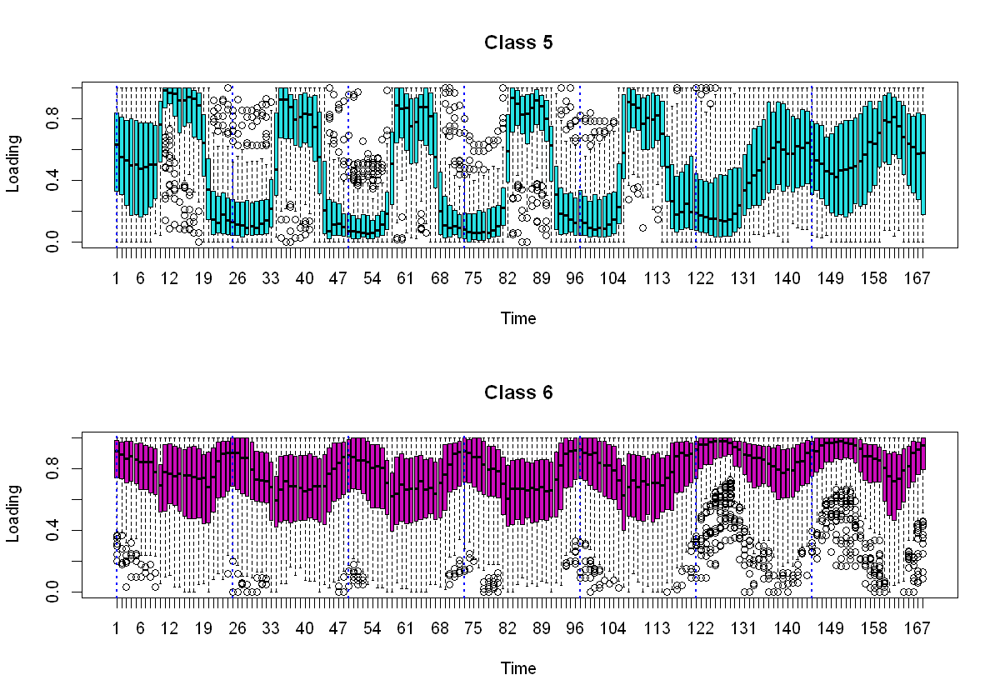

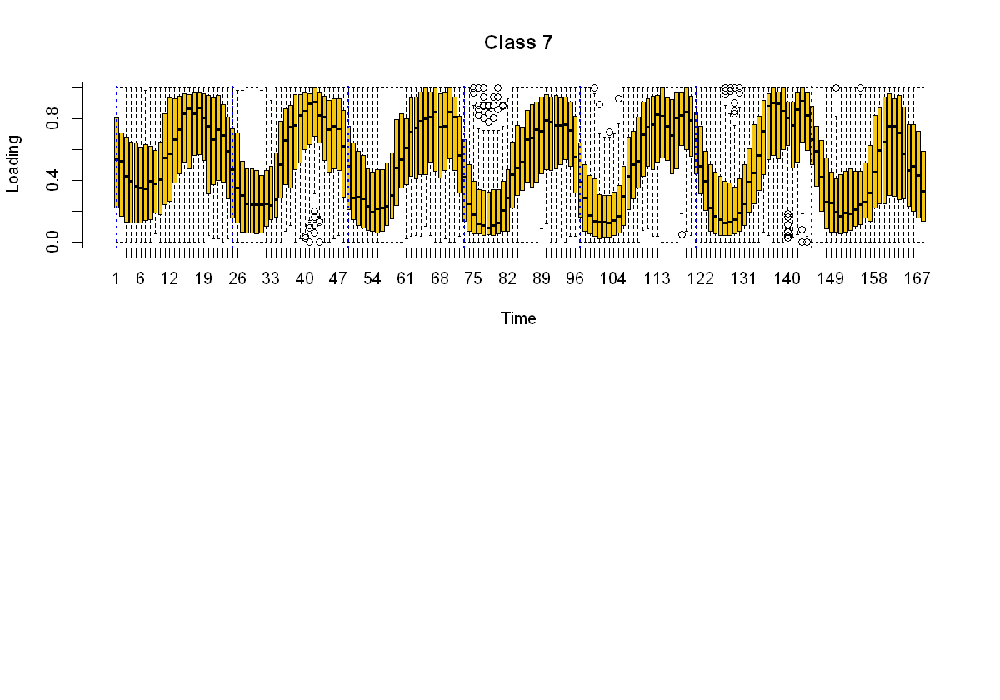

In [35]:
# visualization of the clusters, as time series
options(repr.plot.width = 10, repr.plot.height = 7)
par(mfrow = c(2, 1))
for (l in 1:7){
  boxplot(x[which(km1$cluster == l), ], col = l, 
          xlab = "Time", ylab = "Loading", main = paste("Class", l))
          abline(v = timeTick, lty = "dotted", col = "blue", lwd = 2)
}

# GMM

In [38]:
gmm=Mclust(velo1)

In [39]:
gmm$G

[1] 1

Ca marche dans le mauvais condittion : trop de paramètre (variable) à estimer. Donc c'est normal de considérer le data ACP réduit 

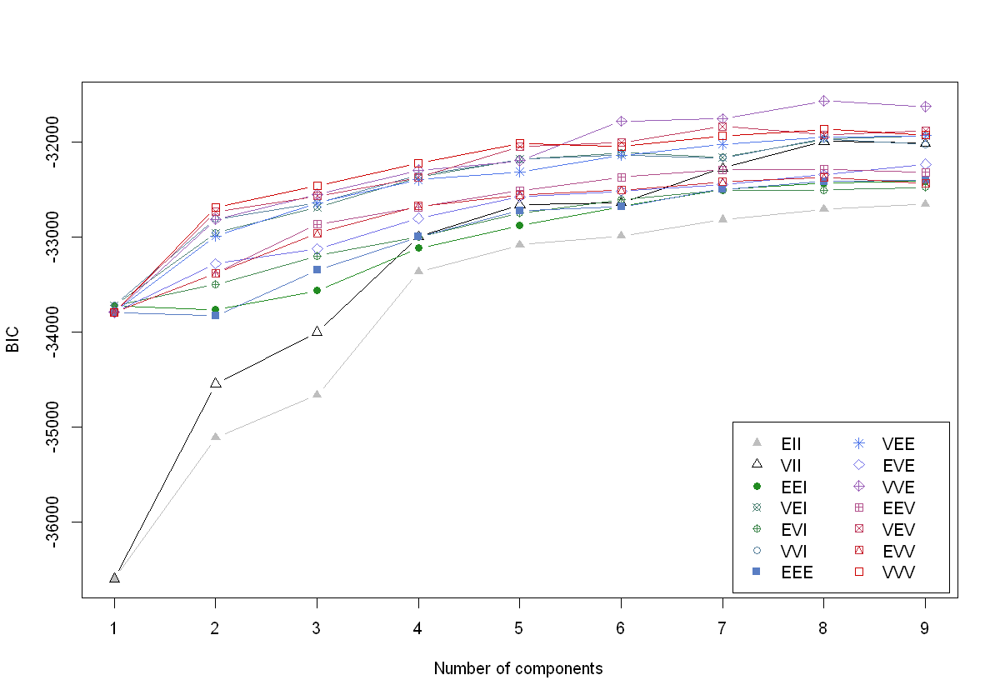

In [40]:
BIC <- mclustBIC(Acp_preparer)
plot(BIC)
# modèle choisi : VVE, G(groupe) = 8

In [41]:
gmm1=Mclust(Acp_preparer)

Using zoom = 12...



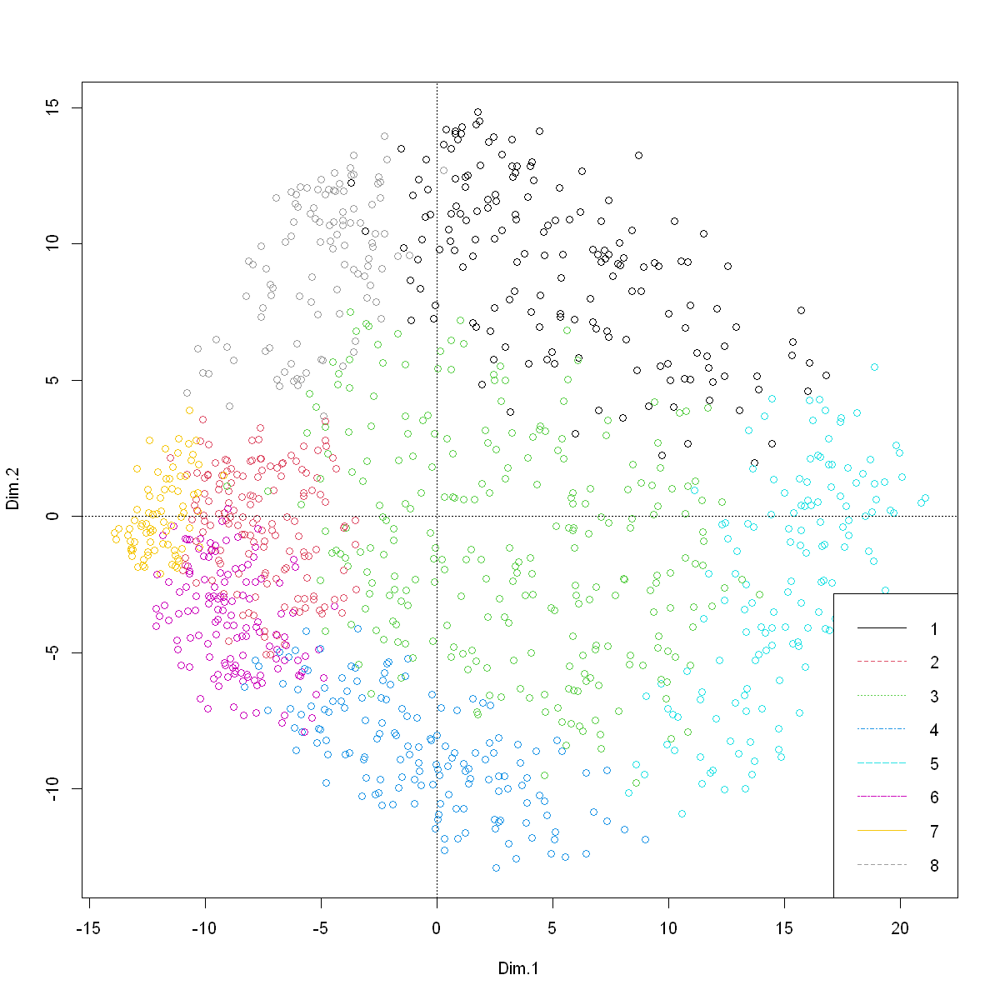

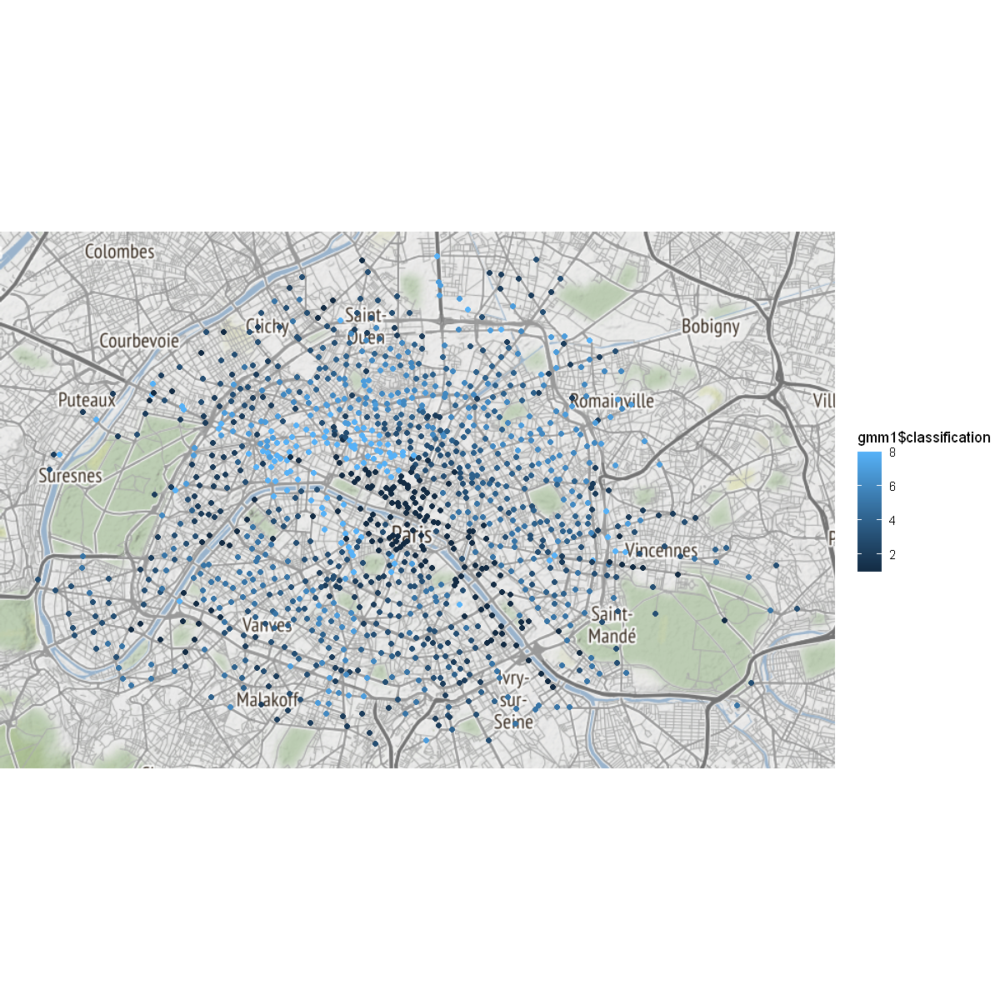

In [42]:
options(repr.plot.width = 10, repr.plot.height = 10)
plot(Acp_preparer, col=gmm1$classification)
abline(v = 0,h=0, lty = "dotted")
legend("bottomright", legend=c(1:8), lty = 1:9, col = 1:9)

qmplot(longitude, latitude, data = velib$position, color = gmm1$classification)

Using zoom = 12...

Using zoom = 12...



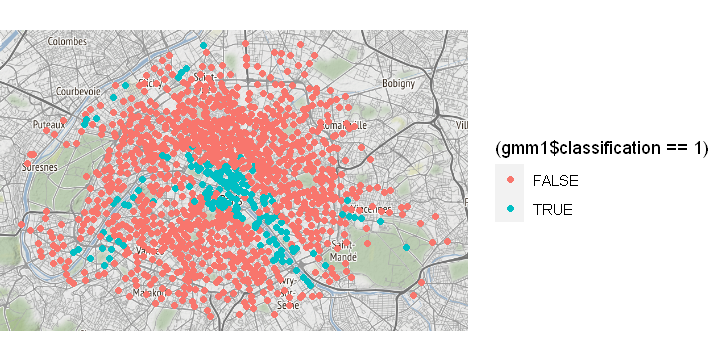

Using zoom = 12...



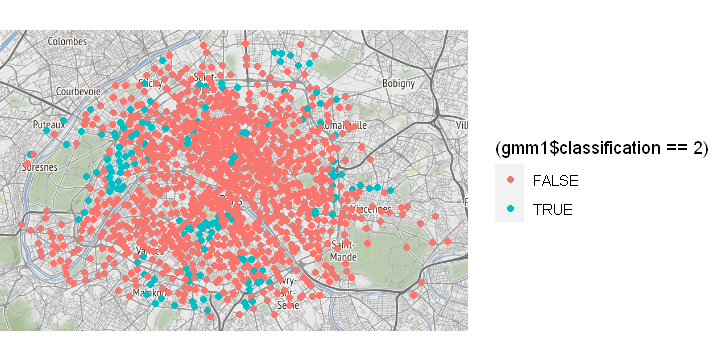

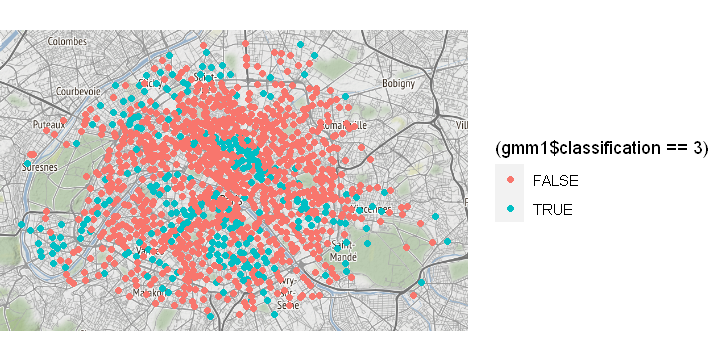

In [48]:
options(repr.plot.width = 6, repr.plot.height = 3)
qmplot(longitude, latitude, data = velib$position, color = (gmm1$classification==1))
qmplot(longitude, latitude, data = velib$position, color = (gmm1$classification==2))
qmplot(longitude, latitude, data = velib$position, color = (gmm1$classification==3))

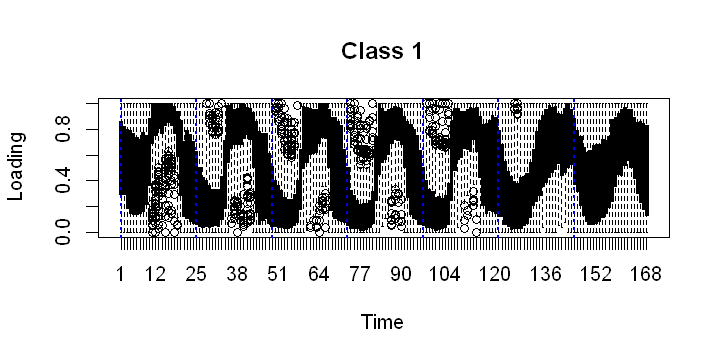

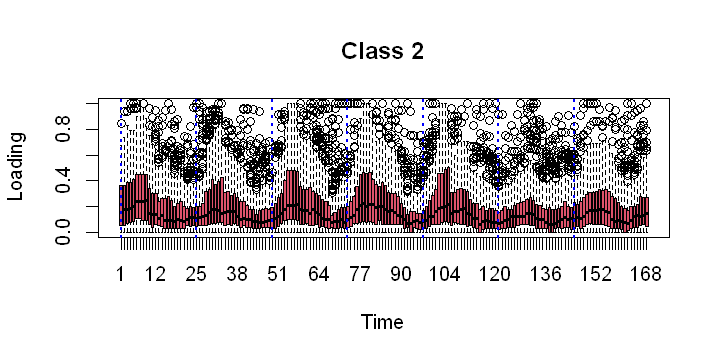

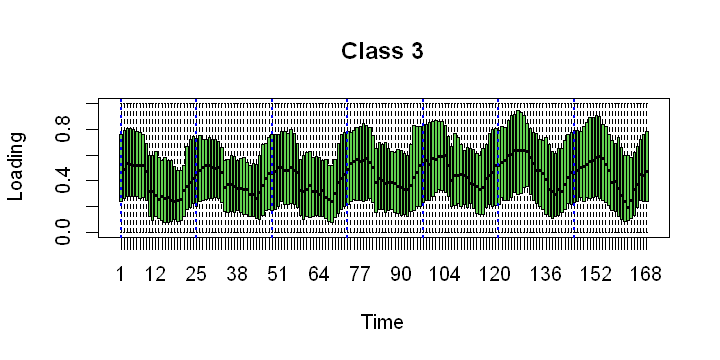

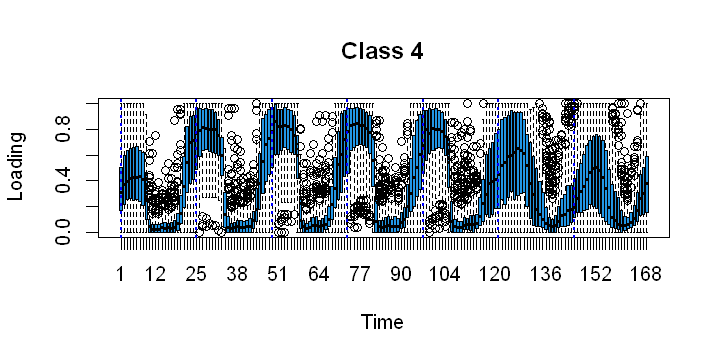

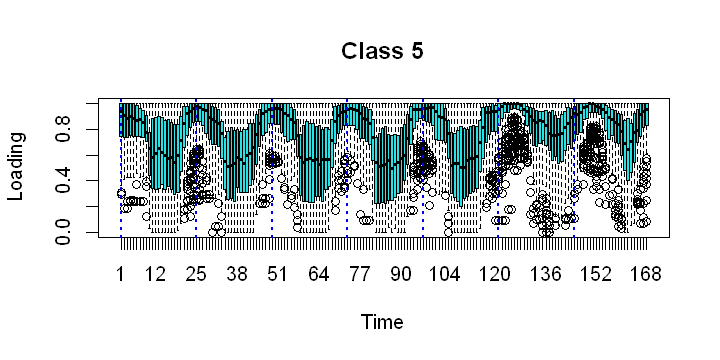

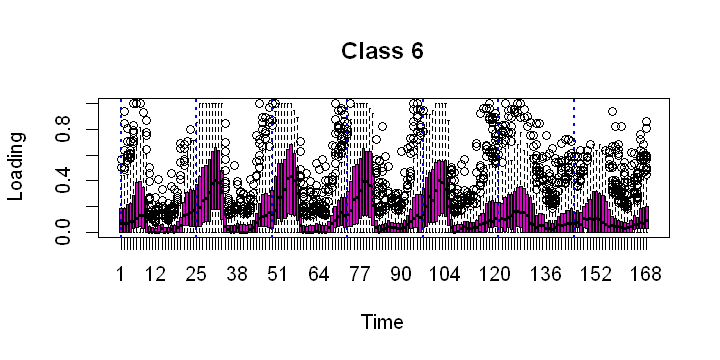

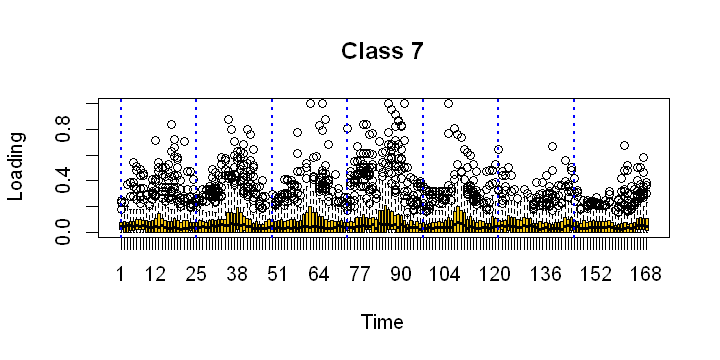

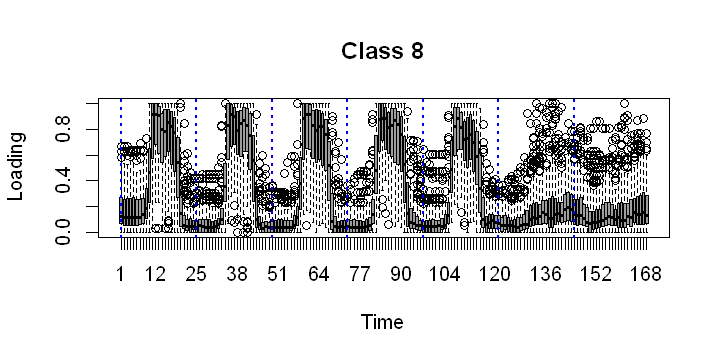

In [49]:
# visualization of the clusters, as time series
for (l in 1:8){
  boxplot(x[which(gmm1$classification == l), ], col = l, 
          xlab = "Time", ylab = "Loading", main = paste("Class", l))
          abline(v = timeTick, lty = "dotted", col = "blue", lwd = 2)
}

# Analyse Correspondant

In [45]:
Xcat <- data.frame(hill = factor(velib$bonus, labels = c("nohill", "hill")))
day <- 7:20
night <- c(1:6, 21:24)
breaks <- c(-0.01, 1/3, 2/3, 1.01)
labels <- letters[1:(length(breaks)-1)]
for (i in 1:7){
  newCol <- rowMeans(x[, day + (i-1)*24])
  newCol <- cut(newCol, breaks = breaks, labels = labels)
  newName <- paste('day', i, sep = '')
  Xcat <- cbind(Xcat, newCol)
  names(Xcat)[ncol(Xcat)] <- newName
}
for (i in 1:7){
  newCol <- rowMeans(x[, night + (i-1)*24])
  newCol <- cut(newCol, breaks = breaks, labels = labels)
  Xcat <- cbind(Xcat, newCol)
  newName <- paste('night', i, sep = '')
  names(Xcat)[ncol(Xcat)] <- newName
}
#rownames(Xcat) <- velib$names
head(Xcat)

,hill,day1,day2,day3,day4,day5,day6,day7,night1,night2,night3,night4,night5,night6,night7
,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>
1,nohill,a,a,a,a,a,a,a,a,b,b,b,c,a,a
2,nohill,a,a,a,a,a,b,b,b,c,c,c,c,c,b
3,nohill,a,c,b,b,b,b,b,a,b,b,b,b,b,b
4,nohill,c,b,b,b,b,b,c,b,a,a,a,a,a,b
5,nohill,c,c,b,b,c,a,b,b,b,b,a,b,b,b
6,nohill,a,a,a,a,a,b,a,b,b,b,b,b,b,a


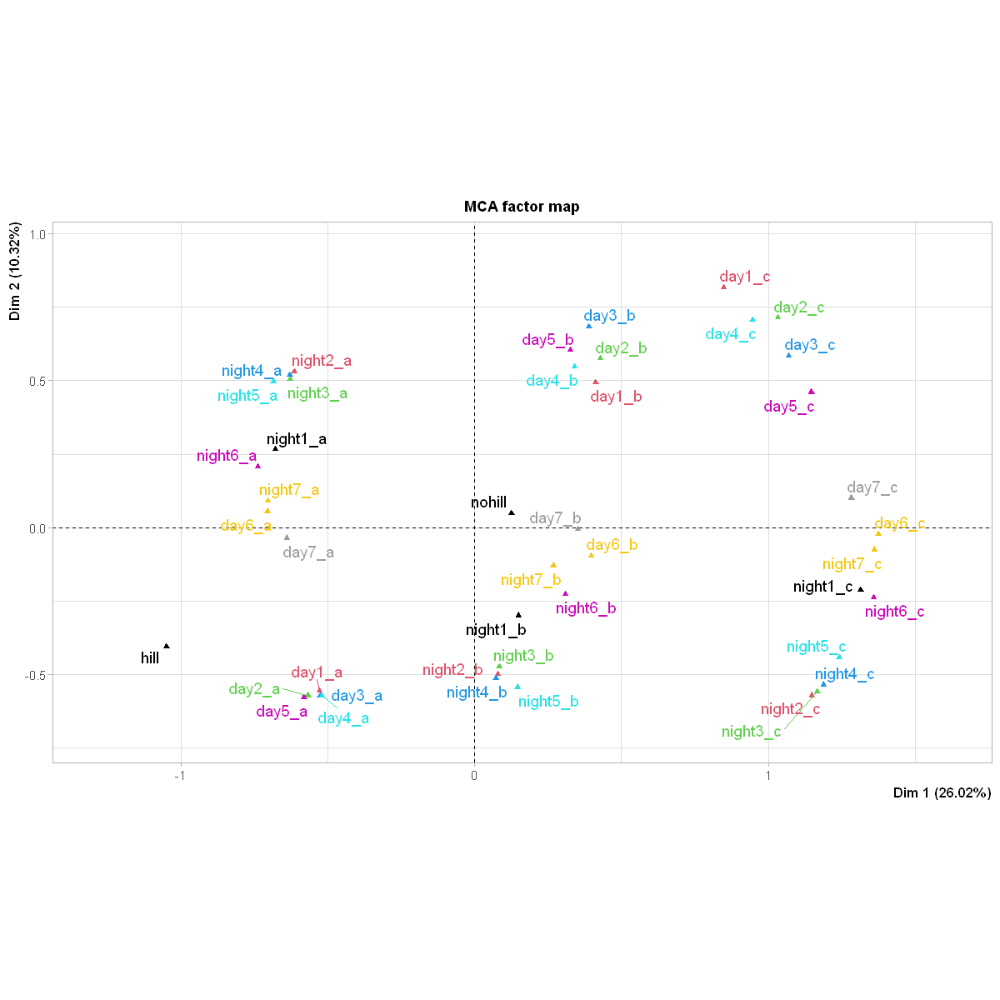

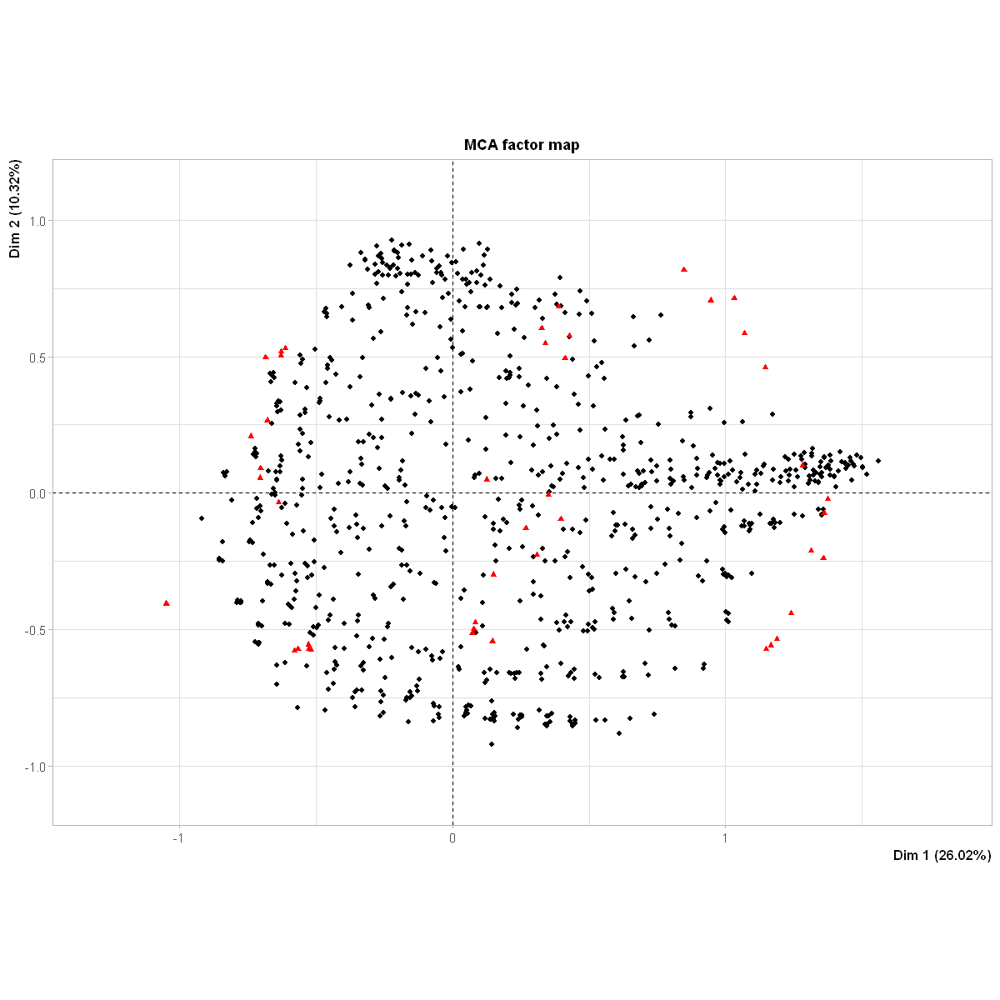

In [46]:
afcm <- MCA(Xcat, graph = FALSE)
options(repr.plot.width = 10, repr.plot.height = 10)
plot(afcm, axes = c(1, 2), choix = "ind", invisible = "ind", habillage = "quali")
plot(afcm, axes = c(1, 2), choix = "ind", label = "no")

In [50]:
# Kmeans sur afcm profile ligne
K <- 8
reskmAFCM <- kmeans(afcm$ind$coord, centers = K, nstart = 10)

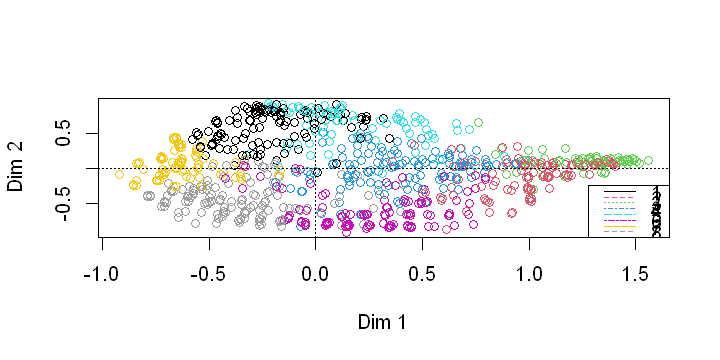

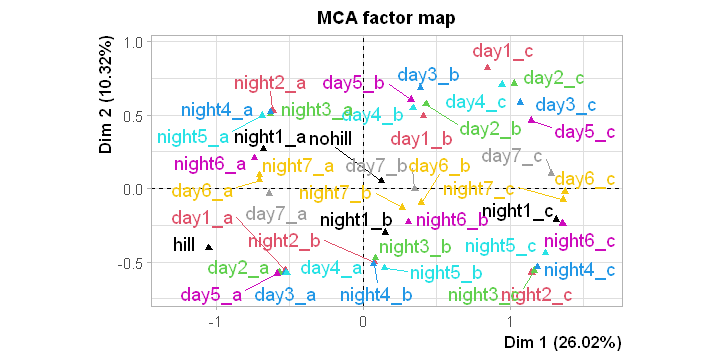

In [51]:
plot(afcm$ind$coord, col=reskmAFCM$cluster)
abline(v = 0,h=0, lty = "dotted")
legend("bottomright", legend=c(1:8), lty = 1:9, col = 1:9)

plot(afcm, axes = c(1, 2), choix = "ind", invisible = "ind", habillage = "quali")

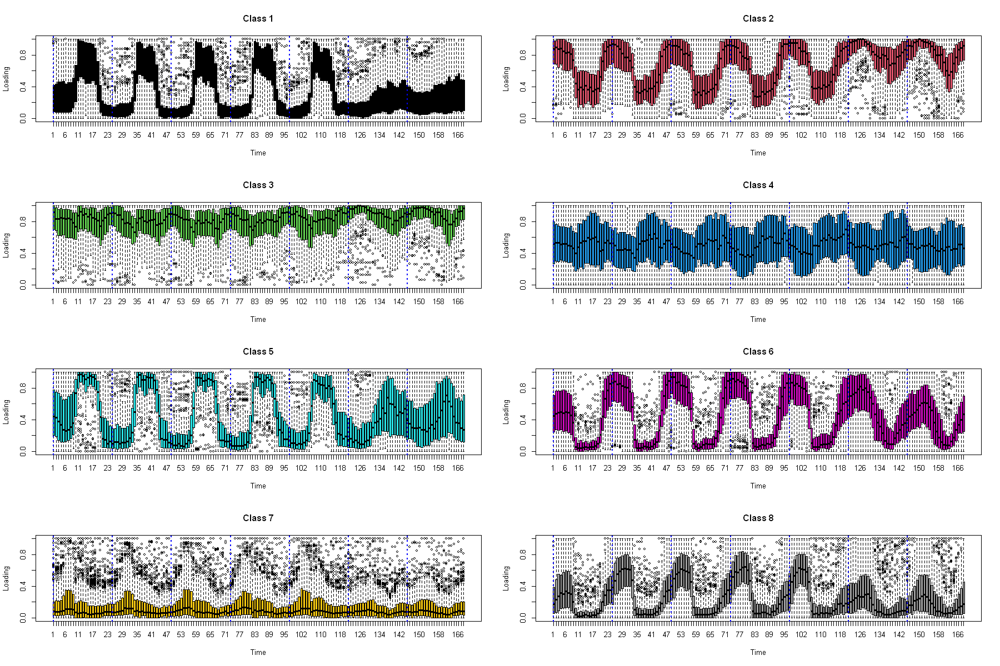

In [52]:
# visualization of the clusters, as time series
par(mfrow = c(4, 2))
options(repr.plot.width = 15, repr.plot.height = 10)
for (l in 1:K){
  boxplot(x[which(reskmAFCM$cluster == l), ], col = l, 
          xlab = "Time", ylab = "Loading", main = paste("Class", l))
  abline(v = timeTick, lty = "dotted", col = "blue", lwd = 2)
}

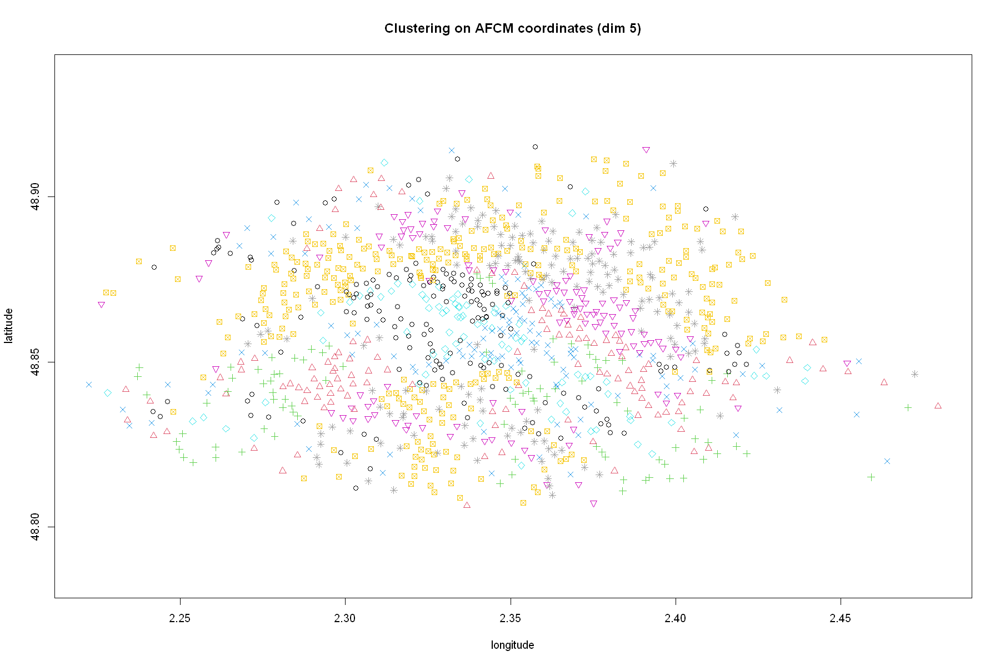

In [53]:
# visualization of the clusters on a 2D map
par(mfrow = c(1, 1))
plot(coord, pch = reskmAFCM$cluster, col = reskmAFCM$cluster, asp = 1, 
     main = "Clustering on AFCM coordinates (dim 5)")

Il y a deux façon d'interprêter les clusters:

- Avec le boxplot temporelle: regarder et interprêter les clusters par rapport à loading moyenne en fonction de temps.

- Avec les composants principals: pour PCA normal interprêter les clusters au sens des premières dimensions, pour AFCM faut lié les clusters aux variables par les pemières dimensions.